In [1]:
import matplotlib.pyplot as plt
import numpy as np
from scipy.signal import savgol_filter
import umap
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torch.optim as optim

from torchvision.utils import make_grid

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
device

device(type='cuda')

In [5]:
import os
os.getcwd()

'/home/linh/projects/test_notebooks'

In [6]:
os.chdir('../IConNet/')

In [7]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"
import gc
import sys
import numpy as np
from tqdm import tqdm

In [8]:
data_dir = '../data/data_preprocessed/crema_d/preprocessed/'
sr = 16000

data_x = np.load(f'{data_dir}crema_d.audio16k.npy', allow_pickle=True)
data_y = np.load(f'{data_dir}crema_d.label_emotion.npy', allow_pickle=True)
classnames = np.load(f'{data_dir}crema_d.classnames.npy', allow_pickle=True)
print(data_x.shape)
print(data_y.shape)
print(classnames)
np.unique(data_y)

(7438,)
(7438,)
['NEU' 'HAP' 'SAD' 'ANG' 'FEA' 'DIS']


array([0, 1, 2, 3, 4, 5], dtype=int16)

In [9]:
labels = ['ANG', 'NEU', 'SAD', 'HAP']

def label_filter(idx):
    return classnames[idx] in labels

def label_to_index(idx):
    return labels.index(classnames[idx])
    
filtered_idx = [label_filter(idx) for idx in data_y]
data_x = data_x[filtered_idx]
data_y = [label_to_index(idx) for idx in data_y[filtered_idx]]
print(data_x.shape)

(4898,)


In [10]:
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(
    data_x, data_y, test_size=0.2, 
    random_state=42, stratify=data_y)
print("Train: %i" % len(x_train))
print("Test: %i" % len(x_test))

Train: 3918
Test: 980


In [11]:
train_set = list(zip(x_train, y_train))
test_set = list(zip(x_test, y_test))

In [12]:
def pad_sequence(batch):
    # Make all tensor in a batch the same length by padding with zeros
    batch = [item.t() for item in batch]
    batch = torch.nn.utils.rnn.pad_sequence(
        batch, batch_first=True, padding_value=0.).permute(0, 2, 1)
    return batch

def collate_fn(batch, max_duration_in_second=3, sample_rate=sr):
    tensors, targets = [], []

    # Gather in lists, and encode labels as indices
    for waveform, label in batch:
        if max_duration_in_second is not None:
            waveform = np.array(waveform, dtype=float).squeeze()
            length = len(waveform)
            max_length = sample_rate * max_duration_in_second
            offset = max(0, (length - max_length) // 2)
            waveform = waveform[offset: length-offset]
        tensors += [torch.tensor(waveform, dtype=torch.float32)[None,:]]
        targets += [torch.tensor(label, dtype=torch.long)]

    # Group the list of tensors into a batched tensor
    tensors = pad_sequence(tensors)
    targets = torch.stack(targets)
    return tensors, targets

batch_size = 16

if device == "cuda":
    num_workers = 1
    pin_memory = True
else:
    num_workers = 0
    pin_memory = False

train_loader = torch.utils.data.DataLoader(
    train_set,
    batch_size=batch_size,
    shuffle=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory, 
    drop_last=True
)
test_loader = torch.utils.data.DataLoader(
    test_set,
    batch_size=batch_size,
    shuffle=False,
    drop_last=True,
    collate_fn=collate_fn,
    num_workers=num_workers,
    pin_memory=pin_memory
)

## Vector Quantizer

In [13]:
from IConNet.acov.zero_crossing import (
    zero_crossings, zero_crossing_rate, 
    zero_crossing_score, samples_like,
    signal_distortion_ratio, signal_loss)
from IConNet.nn.activation import gumbel_softmax

In [14]:
from einops import rearrange

class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost):
        super(VectorQuantizer, self).__init__()

        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings

        self.embedding = nn.Embedding(self.num_embeddings, self.embedding_dim)
        self.embedding.weight.data.uniform_(-1/self.num_embeddings, 1/self.num_embeddings)
        self.commitment_cost = commitment_cost

    def forward(self, inputs):
        eps = torch.finfo(inputs.dtype).eps
        device = inputs.device
        inputs = rearrange(inputs, 'b h c k -> b h c k')
        assert self.embedding_dim ==  inputs.shape[-1]

        flat_input = inputs.view(-1, self.embedding_dim)
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True)
                    + torch.sum(self.embedding.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embedding.weight.t()))

        encoding_indices = torch.argmin(distances, dim=1, keepdim=True)
        encodings = torch.zeros(
            encoding_indices.shape[0], 
            self.num_embeddings, 
            device=device)
        encodings.scatter_(1, encoding_indices, 1)

        quantized = torch.matmul(
            encodings, self.embedding.weight).view(inputs.shape)

        e_latent_loss = F.mse_loss(quantized.detach(), inputs)
        q_latent_loss = F.mse_loss(quantized, inputs.detach())
        loss = q_latent_loss + self.commitment_cost * e_latent_loss

        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + eps)))
        return loss, quantized, perplexity, encodings

## Encoder & Decoder

In [15]:
from typing import Literal
import torch 
from torch import nn, Tensor
from torch.nn import functional as F
from einops import rearrange, reduce, repeat

class LocalPatternFilter(nn.Module):
    def __init__(
        self, 
        in_channels: int, 
        out_channels: int, 
        kernel_size: int=1023,
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ) -> None:
        """
        filter_selection_mode:
            - `fixed`: linspace
            - `zerocrossing`: zerocrossing with gumbel softmax selection 
        """
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.kernel_size = kernel_size
        self.filter_selection_mode = filter_selection_mode
        self.position_concentration = nn.Parameter(torch.rand(self.out_channels))  
        self.pad_layer = PadForConv(
                    kernel_size=self.kernel_size,
                    pad_mode='zero')

    @staticmethod
    def compute_autocovariance(
            X: Tensor,
            positions,
            kernel_size) -> Tensor:
        acov = []
        for position in positions:
            end_pos = position + kernel_size
            frame = X[..., position:end_pos]
            acov += [self.autocovariance(frame)]
        return torch.stack(acov, dim=1)

    @staticmethod
    def autocovariance(filters: Tensor) -> Tensor:
        eps = torch.finfo(filters.dtype).eps
        n = filters.shape[-1]
        filters_max = reduce(filters.abs(), '... n -> ... ()', 'max')
        filters_max = torch.where(filters_max == 0, eps, filters_max)
        win = torch.hann_window(
            window_length=n, 
            dtype=filters.dtype, device=filters.device)
        windowed_data = filters * win / filters_max # normalize
        spectrum = torch.fft.rfft(windowed_data, n=n)**2
        acov = torch.fft.ifftshift(torch.fft.irfft(spectrum.abs(), n=n))
        return acov

    @staticmethod
    def random_filter_positions(
        X: Tensor,
        n_positions: int,
        kernel_size: int,
        end: int,
        mode: Literal['fixed', 'auto']='fixed',
    ):
        if mode=='fixed':
            positions = repeat(
                torch.linspace(
                    start=0, 
                    end=end,
                    steps=n_positions,
                    dtype=torch.int,
                    device=X.device),
                'h -> b h', b=X.shape[0]
            )
        else: # auto: based on zerocrossing
            scores = zero_crossing_score(
                X, n_fft=kernel_size, stride=kernel_size//4)
            scores = gumbel_softmax(scores, tau=1)
            samples = samples_like(
                scores, 
                n_fft=kernel_size, 
                stride=kernel_size//4,
                offset=0, 
                max_sample=end,
                keepdim=False) # (T)
            
            frame_positions = torch.topk(
                scores, n_positions, dim=-1).indices.sort().values
            
            positions = []
            for frame_pos in frame_positions.split(1):
                frame_pos = frame_pos.squeeze()
                positions += [samples.index_select(dim=0, index=frame_pos)]
            positions = torch.stack(positions, dim=0) 
        return positions.contiguous()

    def _generate_filters_idx(self, X: Tensor) -> Tensor:
        length = X.shape[-1]
        end = length - self.kernel_size - 1 - self.kernel_size # TODO: check why -kernel
        n_positions = self.out_channels
        positions = self.random_filter_positions(
            X, n_positions, self.kernel_size,
            end, self.filter_selection_mode)
        positions = rearrange(positions, '... t -> ... t 1')
        filters_idx = torch.concat(
            [positions + i for i in range(self.kernel_size)], 
            dim=-1)
        # print(f'X: {X.shape} | filters_idx: [{filters_idx.min()}, {filters_idx.max()}]')
        return filters_idx

    # def _extract_filters(
    #     self, X: Tensor, filters_idx: Tensor) -> Tensor:
    #     filters = []
    #     z = torch.zeros(
    #         filters_idx.shape[0], filters_idx.shape[1],
    #         X.shape[-1] - self.kernel_size, device=X.device)
    #     filters_idx = torch.concat([filters_idx, z], dim=-1).type(torch.int64)
    #     for idx in filters_idx.split(1, dim=1):
    #         indices = repeat(idx, 'b 1 n -> b c n', c=self.in_channels)
    #         f = torch.gather(
    #             X, dim=-1, index=indices, 
    #             sparse_grad=False)[...,:self.kernel_size]
    #         filters.append(f)
    #     filters = torch.stack(filters, dim=1).contiguous()
    #     return filters

    def _extract_filters(
        self, X: Tensor, filters_idx: Tensor) -> Tensor:
        filters = []
        b, h, n = filters_idx.shape
        for i in range(b):
            filter = []
            for j in range(h):
                filter += [X[i].index_select(dim=-1, index=filters_idx[i, j, :])]
            filter = torch.stack(filter, dim=0)
            filters.append(filter)
        filters = torch.stack(filters, dim=0).contiguous()
        return filters
        
    def _generate_filters(self, X) -> Tensor:
        filters_idx = self._generate_filters_idx(self.pad_layer(X))
        filters = self._extract_filters(X, filters_idx)
        filters = self.autocovariance(filters)
        return filters
    
    def forward(self, X: Tensor) -> Tensor:
        batch_size = X.shape[0]
        filters = self._generate_filters(X)
        assert filters.shape == (batch_size,
                                 self.out_channels, 
                                 self.in_channels, 
                                 self.kernel_size)
        return filters

    

In [16]:
class FilterEnhance(nn.Module):
    def __init__(
        self, 
        in_channels,
        out_channels):
        super().__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        
    def forward(self, X, filters):
        recon_loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
        n_outputs = self.out_channels
        n_batch = X.shape[0]
        for i in range(n_batch):
            X_outs = F.conv1d(
                X, filters[i], padding='same').chunk(n_outputs, dim=1)
            loss = torch.tensor(0., dtype=torch.float64, requires_grad=True)
            for k in range(n_outputs):
                loss = loss + signal_loss(X, X_outs[k])
            recon_loss = recon_loss + loss / n_outputs
        return recon_loss.sum()

## Train

In [17]:
from IConNet.conv.pad import PadForConv
from IConNet.nn.mamba import FeedForward, MambaBlock

In [18]:
num_training_updates = 1000
log_interval = 100
test_interval = 100

in_channels = 1
out_channels = 8
embedding_dim = 1023
num_embeddings = 384

commitment_cost = 0.25

learning_rate = 1e-3
num_tokens = 8
num_classes = 4

In [19]:
class Model(nn.Module):
    def __init__(
        self,
        in_channels: int, 
        out_channels: int,         
        num_embeddings: int, 
        embedding_dim: int, 
        commitment_cost: float,
        num_tokens: int, 
        num_classes: int, 
        filter_selection_mode: Literal['fixed', 'auto']='auto'
    ):
        super(Model, self).__init__()
        self.in_channels = in_channels
        self.out_channels = out_channels
        self.num_embeddings = num_embeddings
        self.embedding_dim = embedding_dim
        self.num_tokens = num_tokens
        self.cls_features = num_embeddings
        self.num_classes = num_classes

        self.encoder = LocalPatternFilter(
            in_channels = in_channels,
            out_channels = out_channels,
            filter_selection_mode=filter_selection_mode
        )
        self.vq_vae = VectorQuantizer(
            num_embeddings, embedding_dim, commitment_cost)
        self.decoder = FilterEnhance(
            in_channels = in_channels,
            out_channels = out_channels
        )
        self.ffn = FeedForward(self.num_embeddings)
        self.ln1 = nn.LayerNorm(self.num_embeddings)
        self.cls_head = nn.Linear(
            self.cls_features, num_classes)
        self.pad_layer = PadForConv(
                    kernel_size=self.num_tokens,
                    pad_mode='mean')

    def project(self, X):
        filters = repeat(
            self.vq_vae.embedding.weight,
            'h n -> h c n', c=self.in_channels)
        X = F.conv1d(X, filters)
        return X

    def classify(self, X):
        X = reduce(rearrange(self.pad_layer(X), 
                      'b h (l t) -> b l t h', l=self.num_tokens),
                  'b l t h -> b l h', 'max')
        X = reduce(self.ffn(self.ln1(X)),
                     'b l h -> b h', 'mean')
        X = self.cls_head(X)
        return X

    def forward(self, X):
        Z = self.encoder(X)
        vq_loss, Z_quantized, perplexity, _ = self.vq_vae(Z)
        recon_loss = self.decoder(X, Z_quantized)
        logits = self.classify(self.project(X))
        return logits, vq_loss, recon_loss, perplexity

In [20]:
model = Model(in_channels, out_channels,
              num_embeddings, embedding_dim,
              commitment_cost, num_tokens, 
              num_classes, filter_selection_mode='auto').to(device)

In [21]:
optimizer = optim.Adam(model.parameters(), lr=learning_rate, amsgrad=False)

In [22]:
test_loader_length = len(test_loader.dataset)

@torch.no_grad()
def test(model, iter):
    model.eval()
    correct = 0
    for data, target in test_loader:
        data = data.to(device)
        target = target.to(device)
        logits, _,_,_ = model(data)
        del data
        gc.collect()
        torch.cuda.empty_cache()
        probs = F.softmax(logits.squeeze(), dim=-1)
        pred = probs.argmax(dim=-1)
        correct += pred.eq(target).sum().item()
        del target
        gc.collect()
        torch.cuda.empty_cache()
    acc = correct / test_loader_length
    print(f"Test iter: {iter}\tAccuracy: {correct}/{test_loader_length} ({100. * acc:.0f}%)\n")
    return acc

In [23]:
model.train()
train_res_recon_error = []
train_res_perplexity = []
train_res_cls_loss = []
test_accuracy = []

for i in range(num_training_updates):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.15*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()

    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        model.train()
        

100 iterations
cls_loss: 1.126
recon_error: 43.362
perplexity: 9.362

Test iter: 100	Accuracy: 509/980 (52%)

200 iterations
cls_loss: 1.017
recon_error: 43.249
perplexity: 7.971

Test iter: 200	Accuracy: 533/980 (54%)

300 iterations
cls_loss: 0.994
recon_error: 43.373
perplexity: 7.786

Test iter: 300	Accuracy: 470/980 (48%)

400 iterations
cls_loss: 0.980
recon_error: 43.421
perplexity: 7.914

Test iter: 400	Accuracy: 545/980 (56%)

500 iterations
cls_loss: 0.950
recon_error: 43.081
perplexity: 7.993

Test iter: 500	Accuracy: 534/980 (54%)

600 iterations
cls_loss: 0.912
recon_error: 43.008
perplexity: 8.103

Test iter: 600	Accuracy: 518/980 (53%)

700 iterations
cls_loss: 0.890
recon_error: 42.278
perplexity: 8.428

Test iter: 700	Accuracy: 544/980 (56%)

800 iterations
cls_loss: 0.844
recon_error: 42.886
perplexity: 8.637

Test iter: 800	Accuracy: 545/980 (56%)

900 iterations
cls_loss: 0.880
recon_error: 42.016
perplexity: 8.693

Test iter: 900	Accuracy: 582/980 (59%)

1000 itera

In [24]:
from IConNet.acov.visualize import (
    visualize_speech_codebook, get_embedding_color, 
    visualize_embedding_umap, visualize_training_curves
)

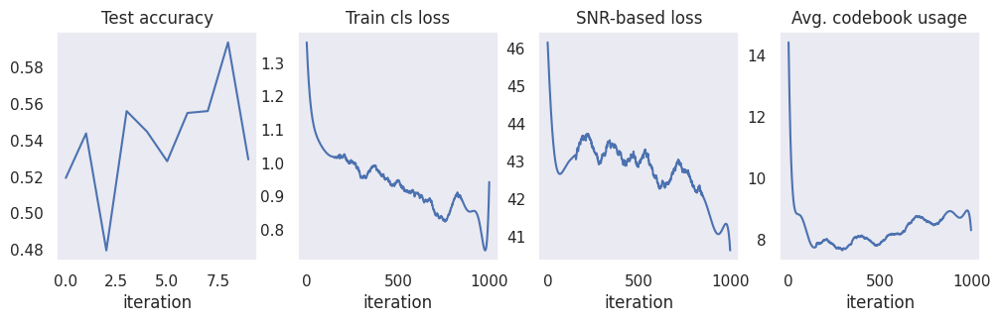

In [25]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [26]:
emb_data = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data)

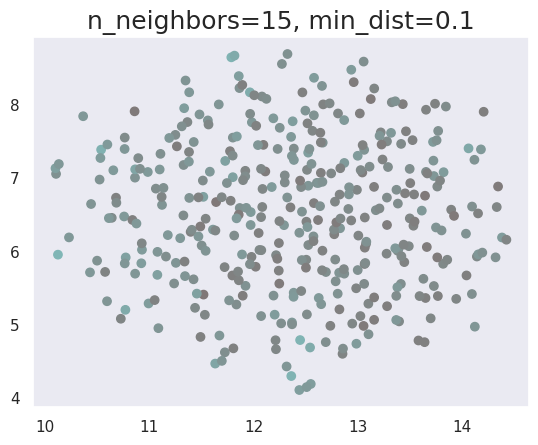

In [27]:
k = 15
min_dist=0.1
visualize_embedding_umap(emb_data, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

/opt/anaconda3/envs/audio/lib/python3.9/site-packages/librosa/feature/spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


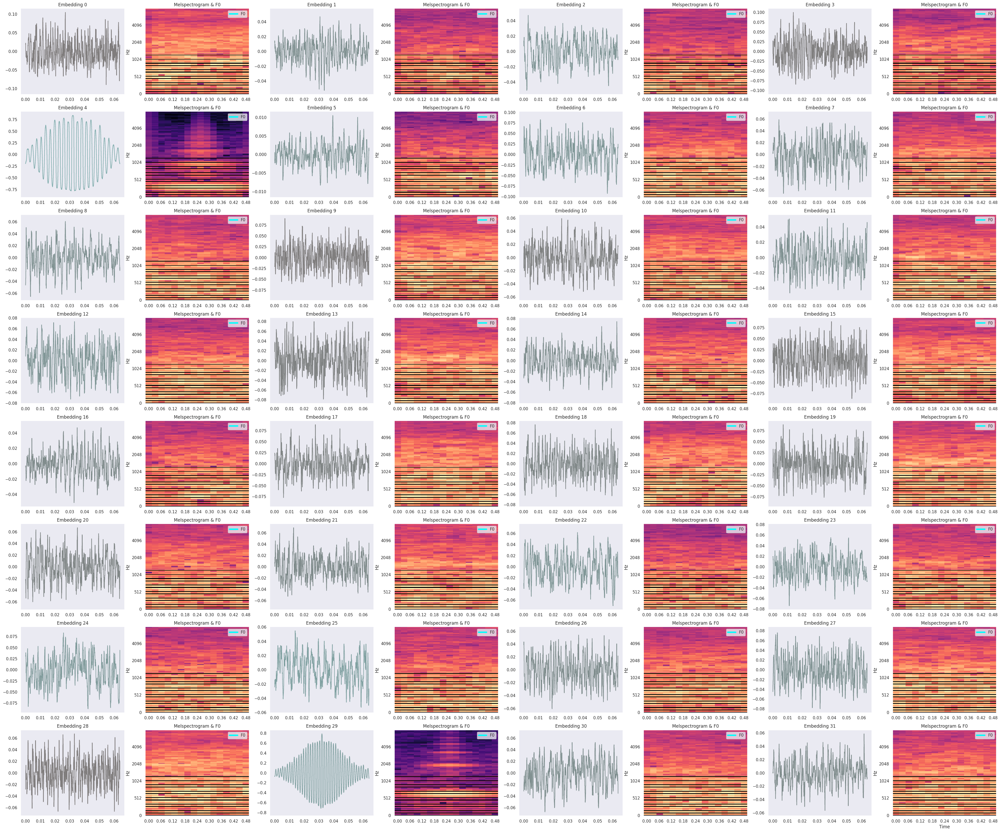

In [28]:
visualize_speech_codebook(emb_data.numpy(), n=64, colors=emb_color)

(array([   645.,   1563.,   1310.,   1661., 280691., 102864.,   1227.,
          1166.,   1191.,    514.]),
 array([-0.97438365, -0.77658492, -0.57878619, -0.38098744, -0.18318871,
         0.01461002,  0.21240875,  0.41020748,  0.60800624,  0.80580497,
         1.0036037 ]),
 <BarContainer object of 10 artists>)

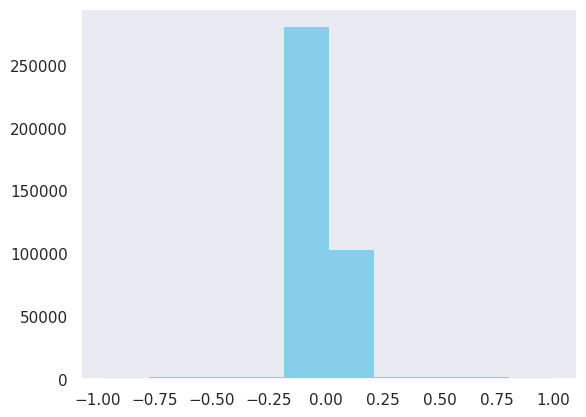

In [29]:
plt.hist(emb_data.numpy().flatten(), color = "skyblue", lw=0)

/tmp/ipykernel_2908781/3805851421.py:1: RuntimeWarning: invalid value encountered in log
  plt.hist(np.log(emb_data.numpy().flatten()), color = "skyblue", lw=0)


(array([6.00000e+00, 2.70000e+01, 1.20000e+02, 5.21000e+02, 2.49100e+03,
        1.13430e+04, 4.91060e+04, 1.14502e+05, 1.16660e+04, 4.05100e+03]),
 array([-1.52477055e+01, -1.37225752e+01, -1.21974449e+01, -1.06723146e+01,
        -9.14718437e+00, -7.62205410e+00, -6.09692383e+00, -4.57179356e+00,
        -3.04666328e+00, -1.52153301e+00,  3.59721924e-03]),
 <BarContainer object of 10 artists>)

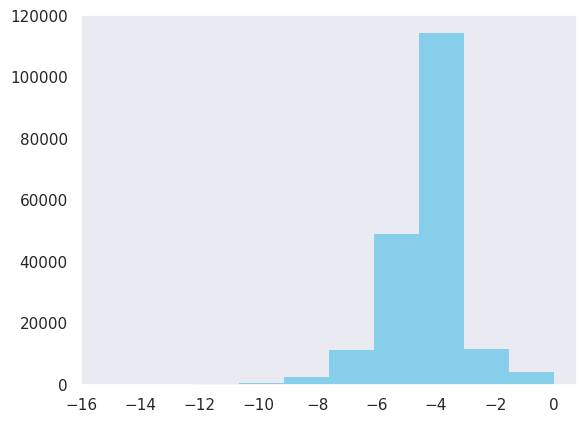

In [30]:
plt.hist(np.log(emb_data.numpy().flatten()), color = "skyblue", lw=0)

In [31]:
additional_steps = 1700
for i in range(num_training_updates, num_training_updates+additional_steps):
    (data, target) = next(iter(train_loader))
    data = data.to(device)
    target = target.to(device)
    optimizer.zero_grad()

    logits, vq_loss, recon_loss, perplexity = model(data)
    cls_loss = F.cross_entropy(logits.squeeze(), target)
    loss = vq_loss + recon_loss + 0.1*cls_loss
    loss.backward()
    optimizer.step()

    train_res_recon_error.append(recon_loss.item())
    train_res_perplexity.append(perplexity.item())
    train_res_cls_loss.append(cls_loss.item())

    del data, target
    gc.collect()
    torch.cuda.empty_cache() 

    if (i+1) % log_interval == 0:
        print('%d iterations' % (i+1))
        print('cls_loss: %.3f' % np.mean(train_res_cls_loss[-log_interval:]))
        print('recon_error: %.3f' % np.mean(train_res_recon_error[-log_interval:]))
        print('perplexity: %.3f' % np.mean(train_res_perplexity[-log_interval:]))
        print()
    if (i+1) % test_interval == 0:
        model.eval()
        acc = test(model, i+1)
        test_accuracy.append(acc)
        model.train()
        

1100 iterations
cls_loss: 0.770
recon_error: 40.233
perplexity: 9.135

Test iter: 1100	Accuracy: 600/980 (61%)

1200 iterations
cls_loss: 0.743
recon_error: 39.998
perplexity: 9.214

Test iter: 1200	Accuracy: 559/980 (57%)

1300 iterations
cls_loss: 0.710
recon_error: 41.120
perplexity: 9.122

Test iter: 1300	Accuracy: 592/980 (60%)

1400 iterations
cls_loss: 0.713
recon_error: 42.805
perplexity: 9.275

Test iter: 1400	Accuracy: 587/980 (60%)

1500 iterations
cls_loss: 0.685
recon_error: 41.948
perplexity: 9.387

Test iter: 1500	Accuracy: 587/980 (60%)

1600 iterations
cls_loss: 0.643
recon_error: 44.279
perplexity: 9.453

Test iter: 1600	Accuracy: 599/980 (61%)

1700 iterations
cls_loss: 0.645
recon_error: 44.328
perplexity: 9.823

Test iter: 1700	Accuracy: 573/980 (58%)

1800 iterations
cls_loss: 0.659
recon_error: 42.931
perplexity: 9.665

Test iter: 1800	Accuracy: 595/980 (61%)

1900 iterations
cls_loss: 0.615
recon_error: 42.224
perplexity: 9.836

Test iter: 1900	Accuracy: 584/980

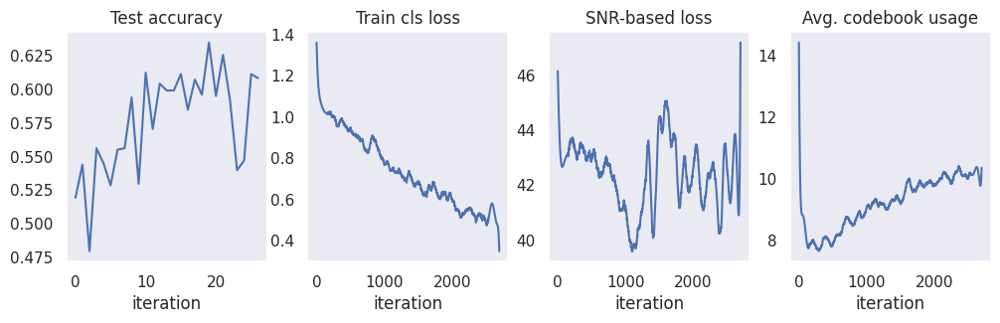

In [32]:
visualize_training_curves(
    test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity
)

In [33]:
emb_data2 = model.vq_vae.embedding.weight.data.cpu()
emb_color, zcs = get_embedding_color(emb_data2)

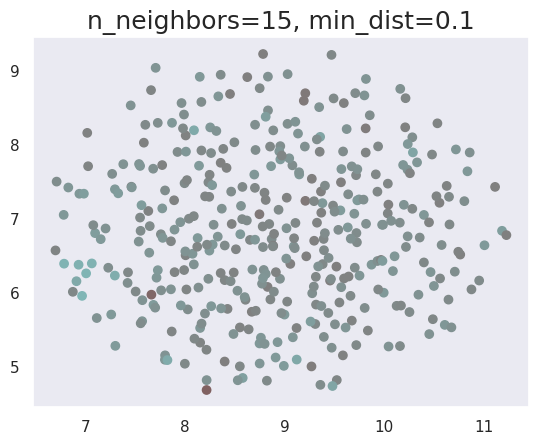

In [34]:
k = 15
min_dist=0.1
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

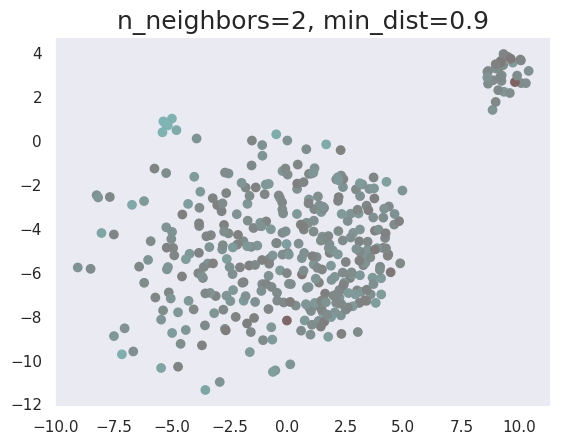

In [198]:
k = 2
min_dist=0.9
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

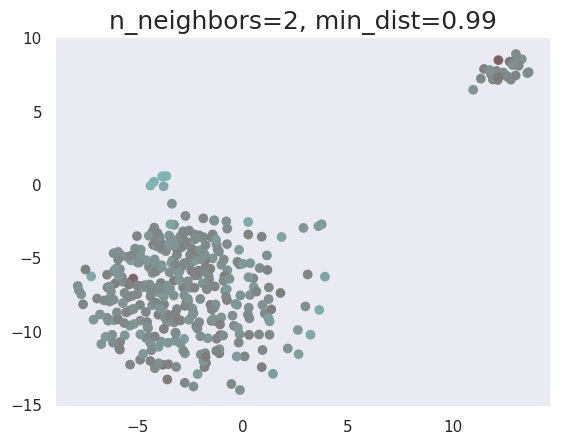

In [199]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

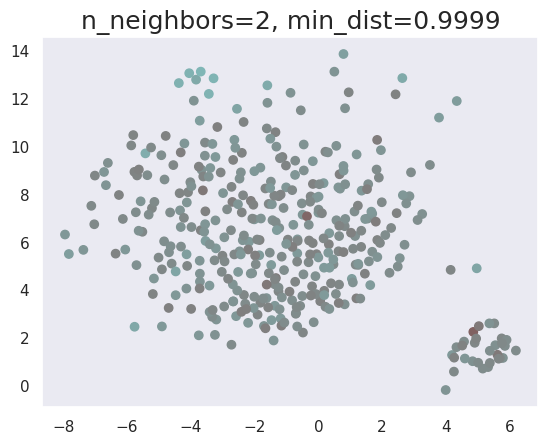

In [207]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='euclidean', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

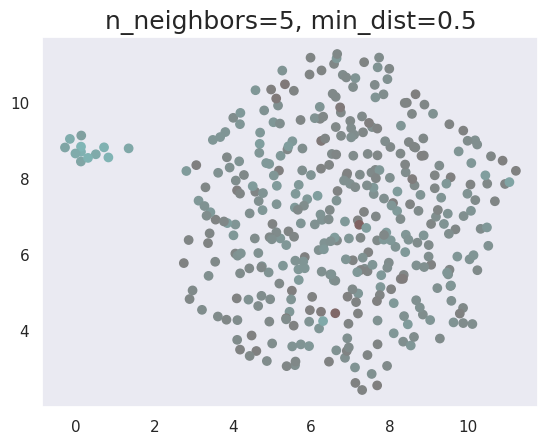

In [187]:
k = 5
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

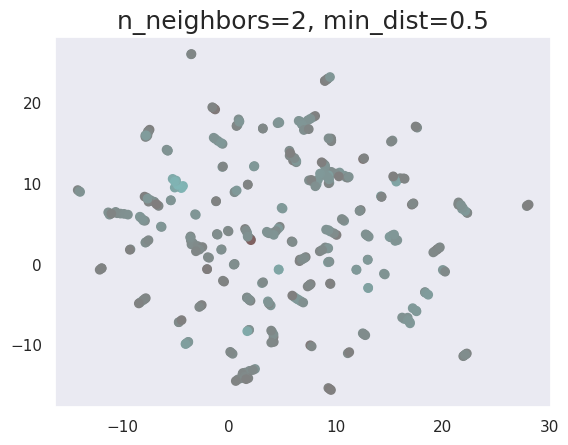

In [192]:
k = 2
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

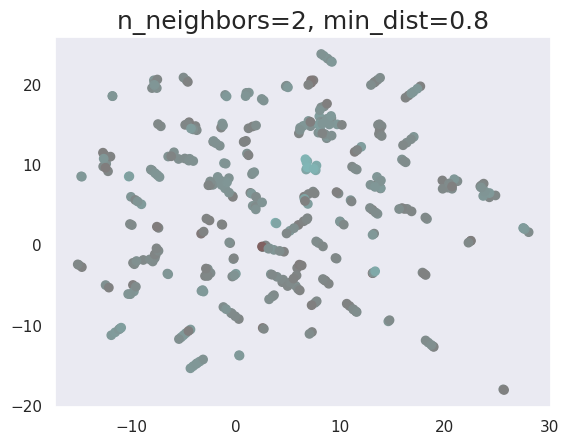

In [193]:
k = 2
min_dist=0.8
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

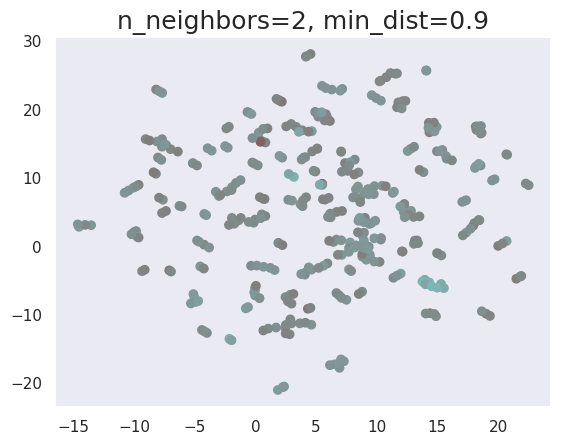

In [195]:
k = 2
min_dist=0.9
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

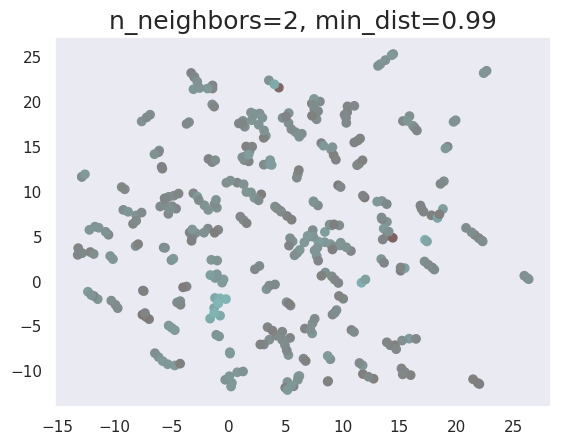

In [200]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

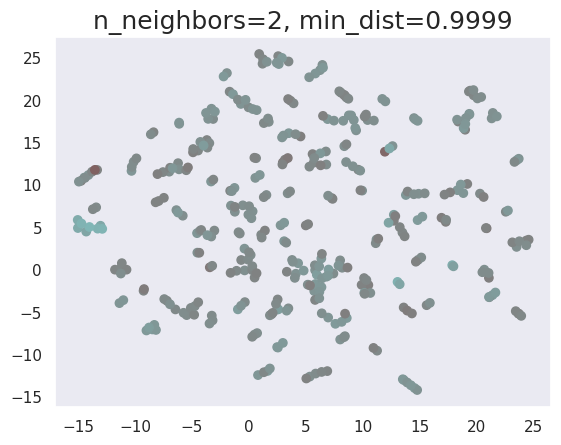

In [208]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='braycurtis', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

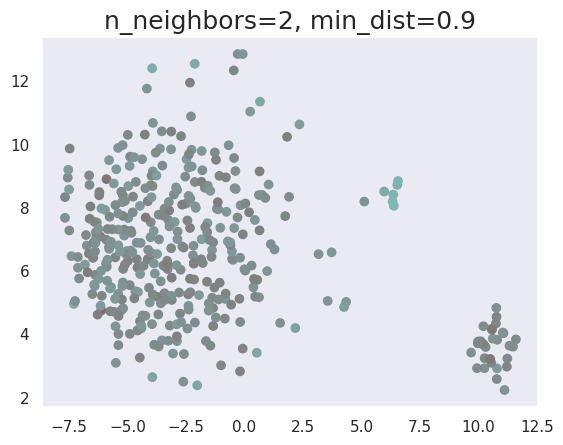

In [196]:
k = 2
min_dist=0.9
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='minkowski', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

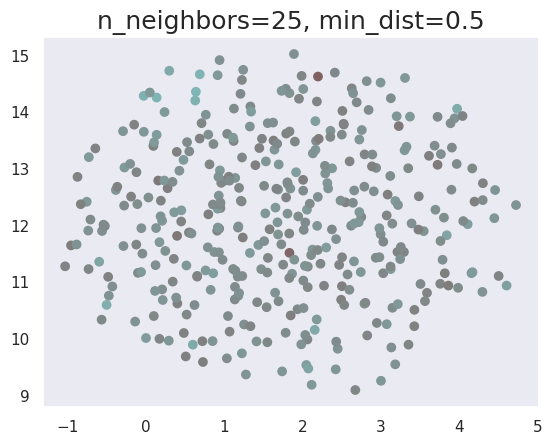

In [197]:
k = 25
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='minkowski', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

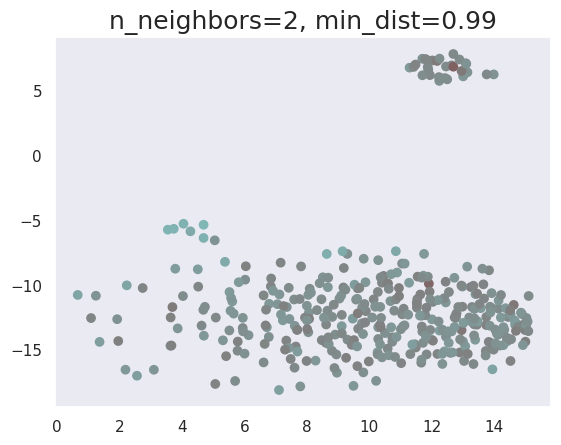

In [201]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='minkowski', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

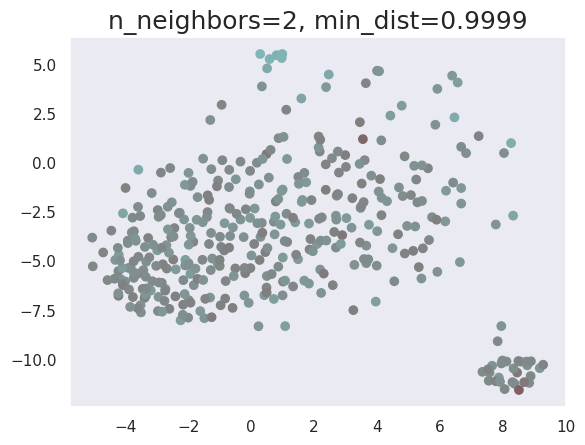

In [209]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='minkowski', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

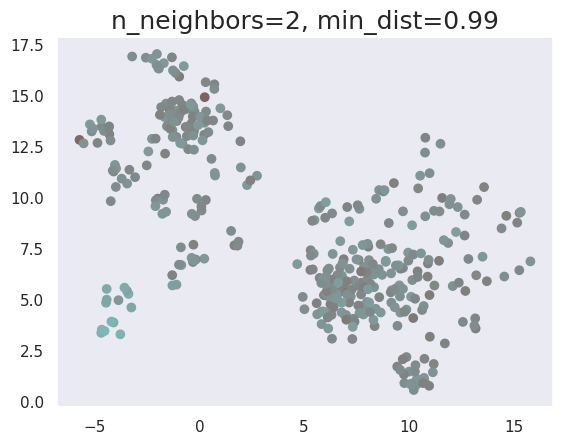

In [202]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

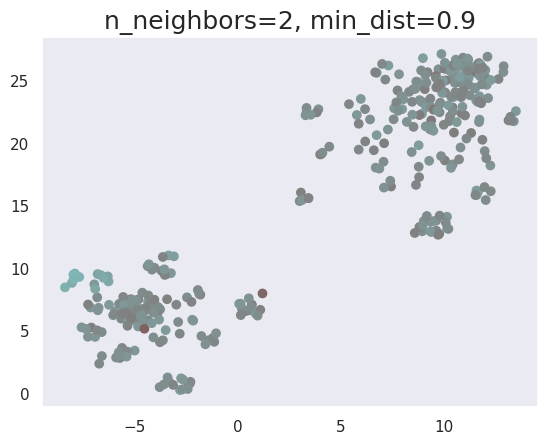

In [204]:
k = 2
min_dist=0.9
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

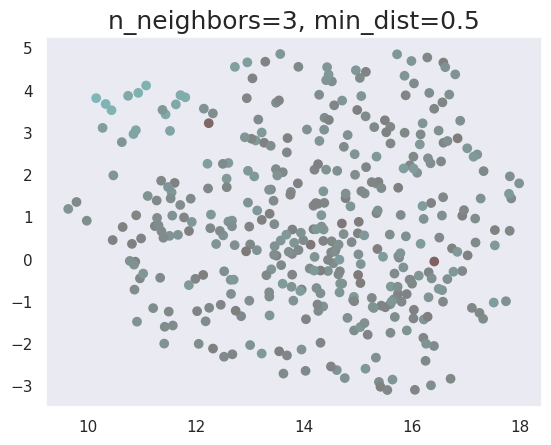

In [203]:
k = 3
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

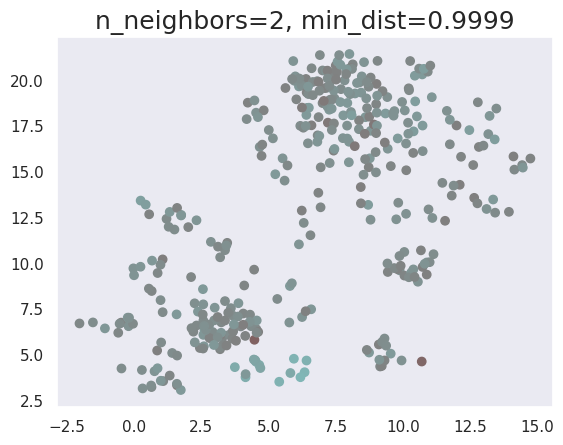

In [210]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='chebyshev', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

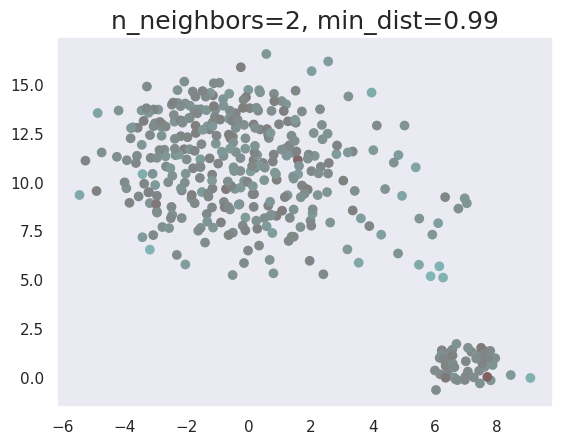

In [205]:
k = 2
min_dist=0.99
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='manhattan', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

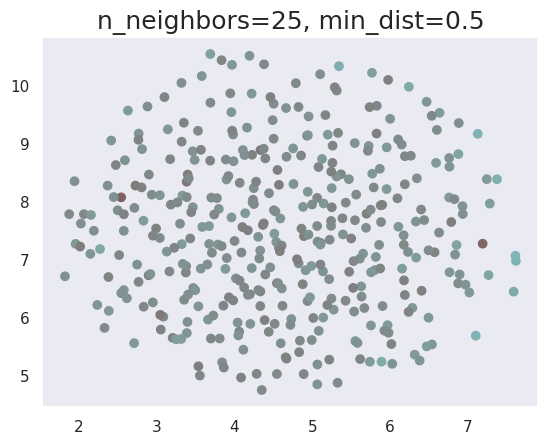

In [206]:
k = 25
min_dist=0.5
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='manhattan', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

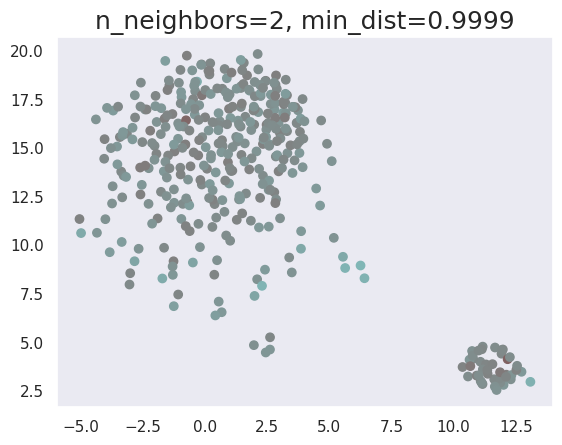

In [211]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='manhattan', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

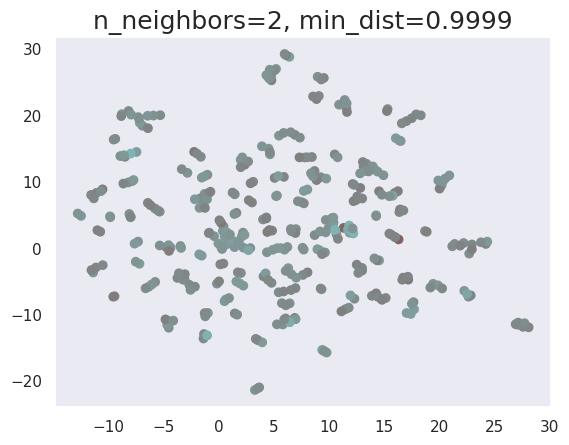

In [212]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='correlation', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

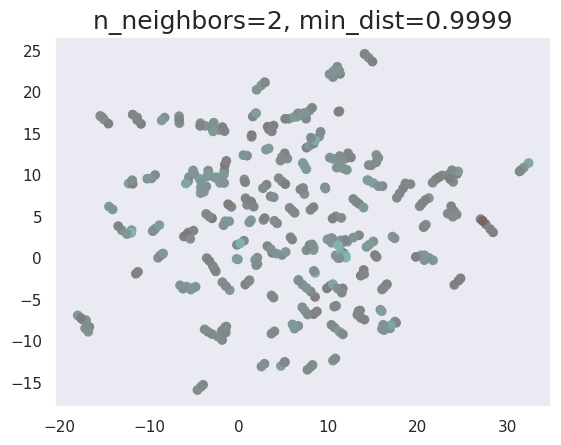

In [213]:
k = 2
min_dist=0.9999
visualize_embedding_umap(emb_data2, colors=emb_color, edgecolors=None,
          n_neighbors=k, min_dist=min_dist, metric='cosine', 
          title=f'n_neighbors={k}, min_dist={min_dist}')

/opt/anaconda3/envs/audio/lib/python3.9/site-packages/librosa/feature/spectral.py:2143: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


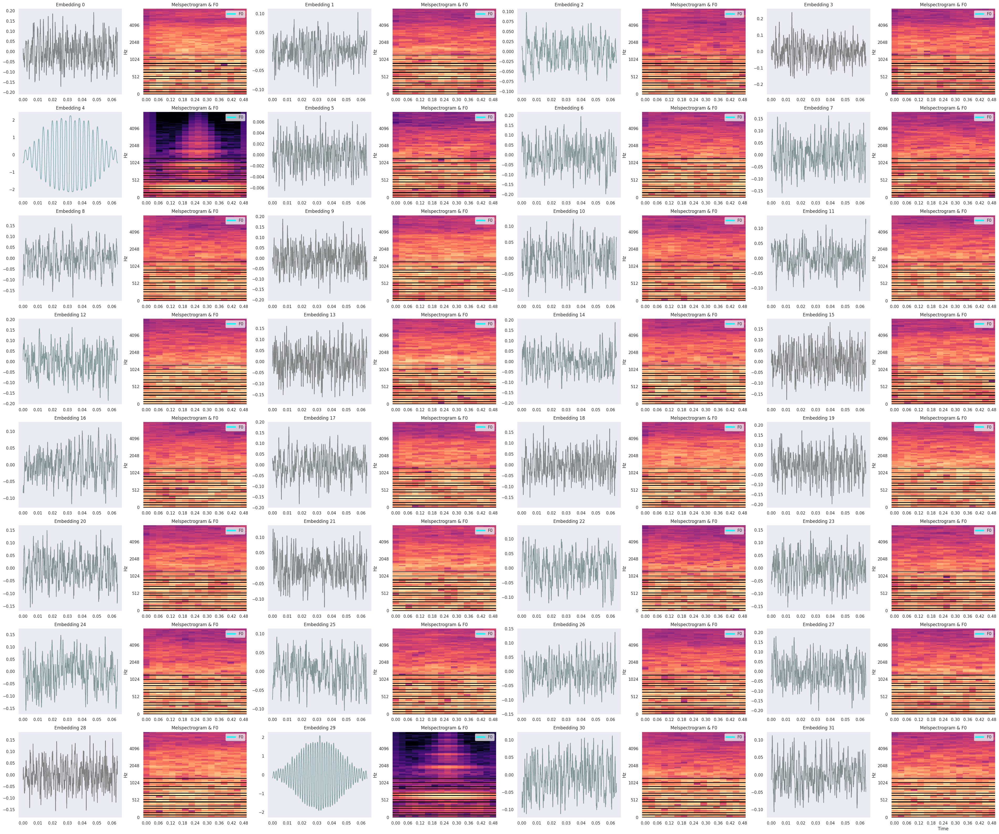

In [35]:
visualize_speech_codebook(emb_data2.numpy(), n=64, colors=emb_color)

In [36]:
torch.topk(zcs, 32)

torch.return_types.topk(
values=tensor([0.7146, 0.7049, 0.7000, 0.6976, 0.6951, 0.6800, 0.6723, 0.6671, 0.6645,
        0.6592, 0.6486, 0.6459, 0.6432, 0.6269, 0.6187, 0.6187, 0.6187, 0.6187,
        0.6173, 0.6159, 0.6117, 0.6103, 0.6075, 0.6075, 0.6061, 0.6061, 0.6061,
        0.6047, 0.6047, 0.6033, 0.6019, 0.6019]),
indices=tensor([277, 233, 379, 127, 213,   4, 287,  49, 256, 125, 235, 366, 138,  29,
        122, 298, 207, 208, 163, 336, 285, 347, 115, 280,  69,  59, 244, 145,
        314,  61,  73, 348]))

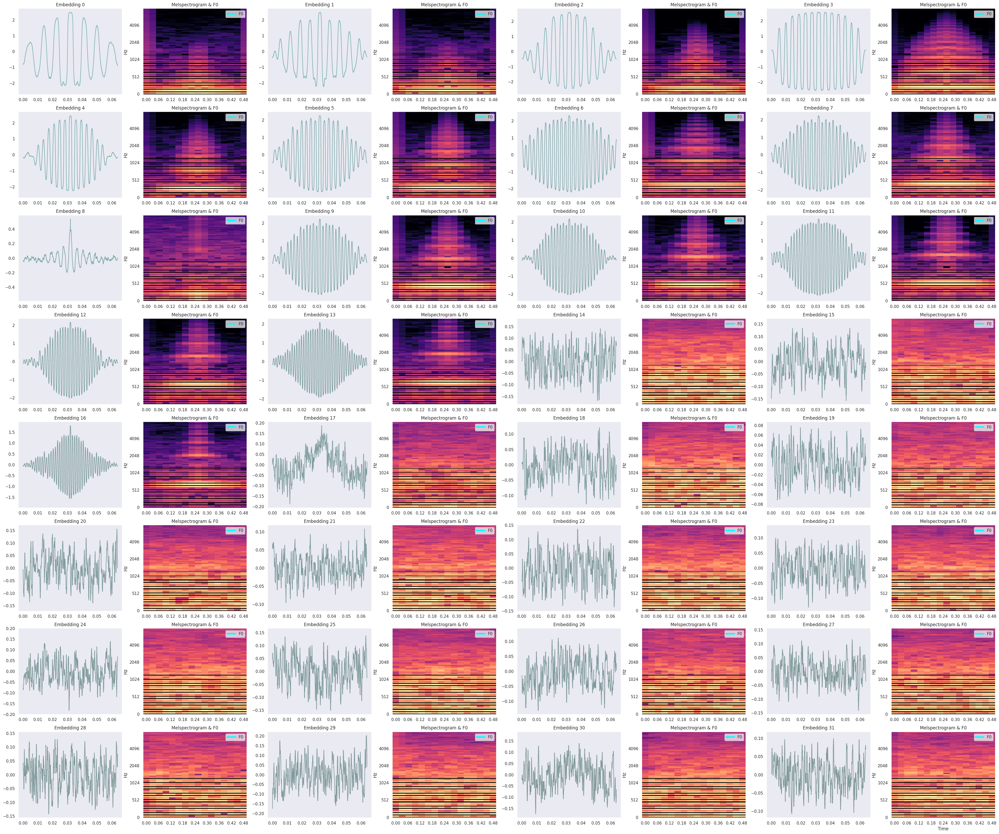

In [40]:
selected_emb_topk = torch.topk(zcs, 32)
selected_emb = emb_data2.index_select(dim=0, index=selected_emb_topk.indices)
selected_emb_color = torch.stack(
        [torch.full_like(selected_emb_topk.values, 0.5), 
         selected_emb_topk.values, selected_emb_topk.values], 
        dim=-1).numpy()
visualize_speech_codebook(selected_emb.numpy(), n=64, colors=selected_emb_color)

In [41]:
emb_color[[1,2,4]]

array([[0.5       , 0.5402354 , 0.5402354 ],
       [0.5       , 0.60051817, 0.60051817],
       [0.5       , 0.6799769 , 0.6799769 ]], dtype=float32)

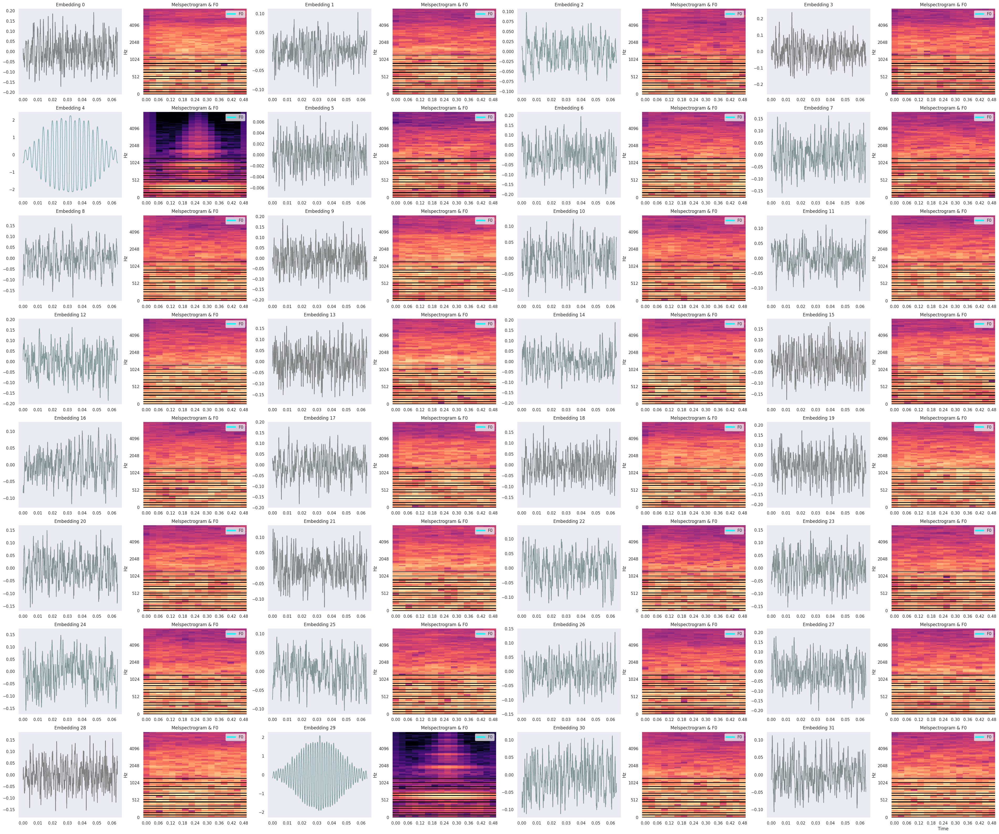

In [43]:
k, bz = 0, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

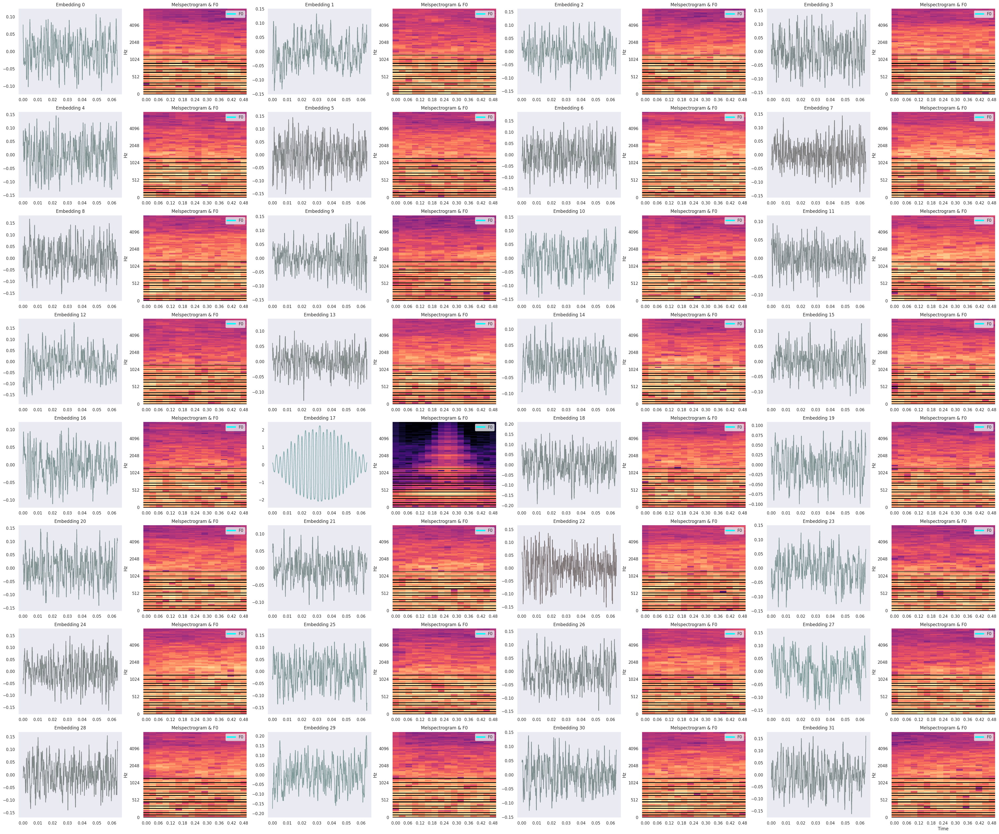

In [44]:
k, bz = 1, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

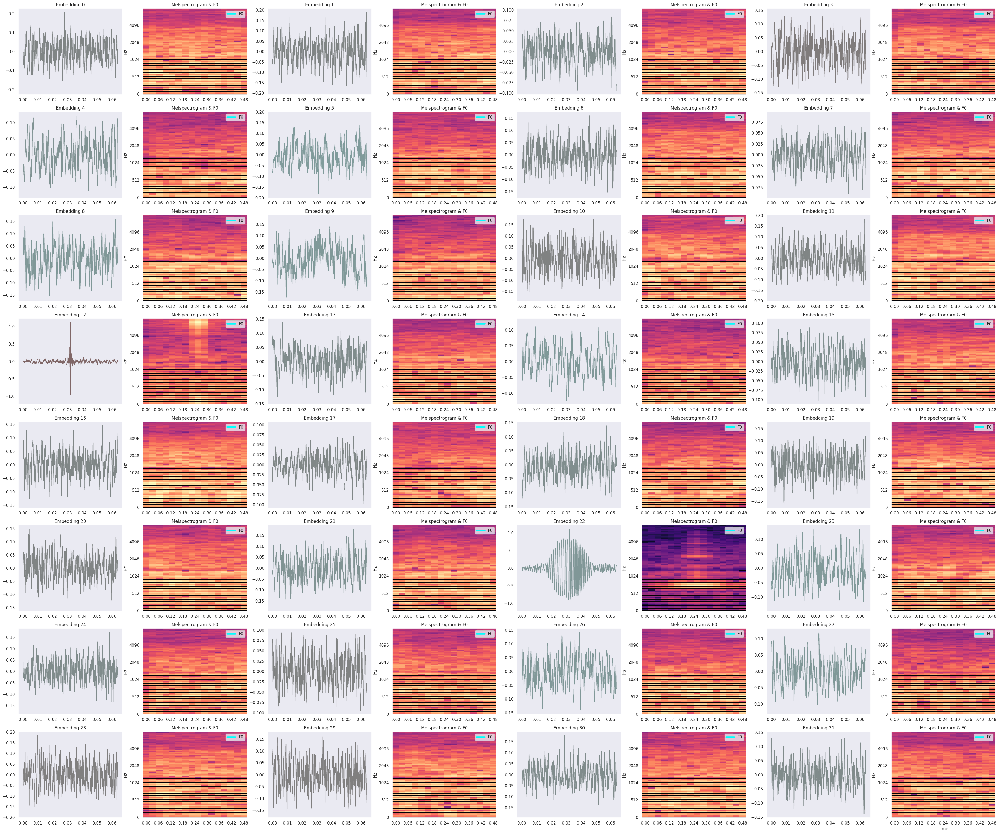

In [45]:
k, bz = 2, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

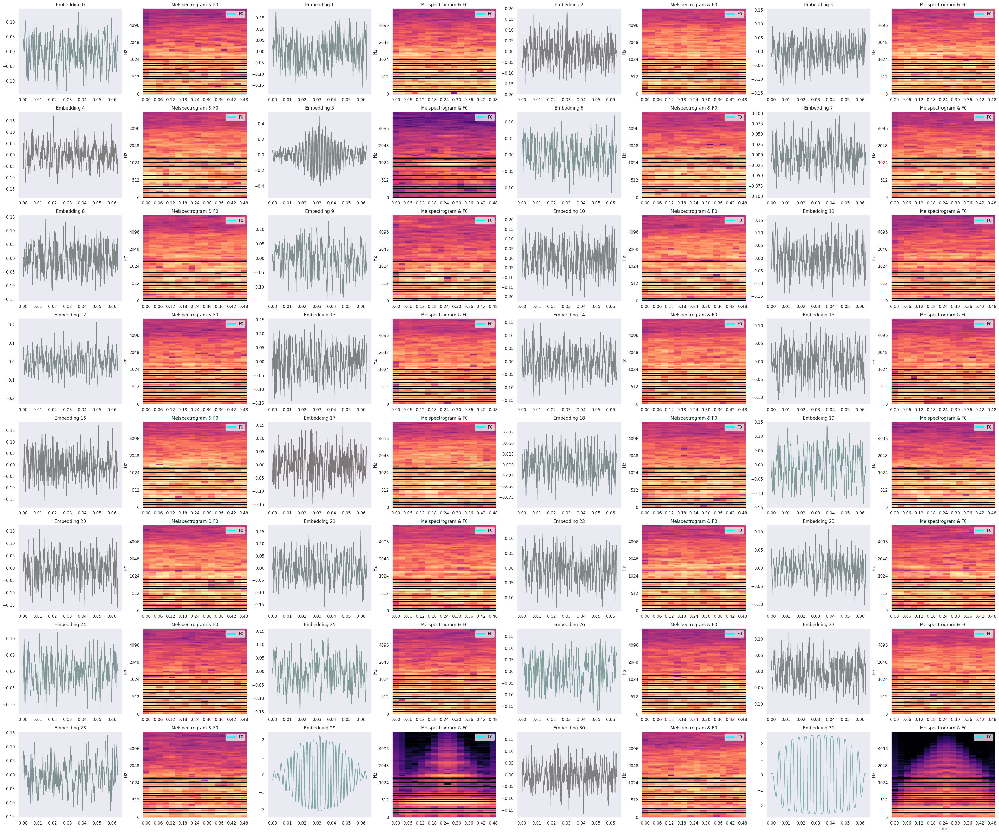

In [46]:
k, bz = 3, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

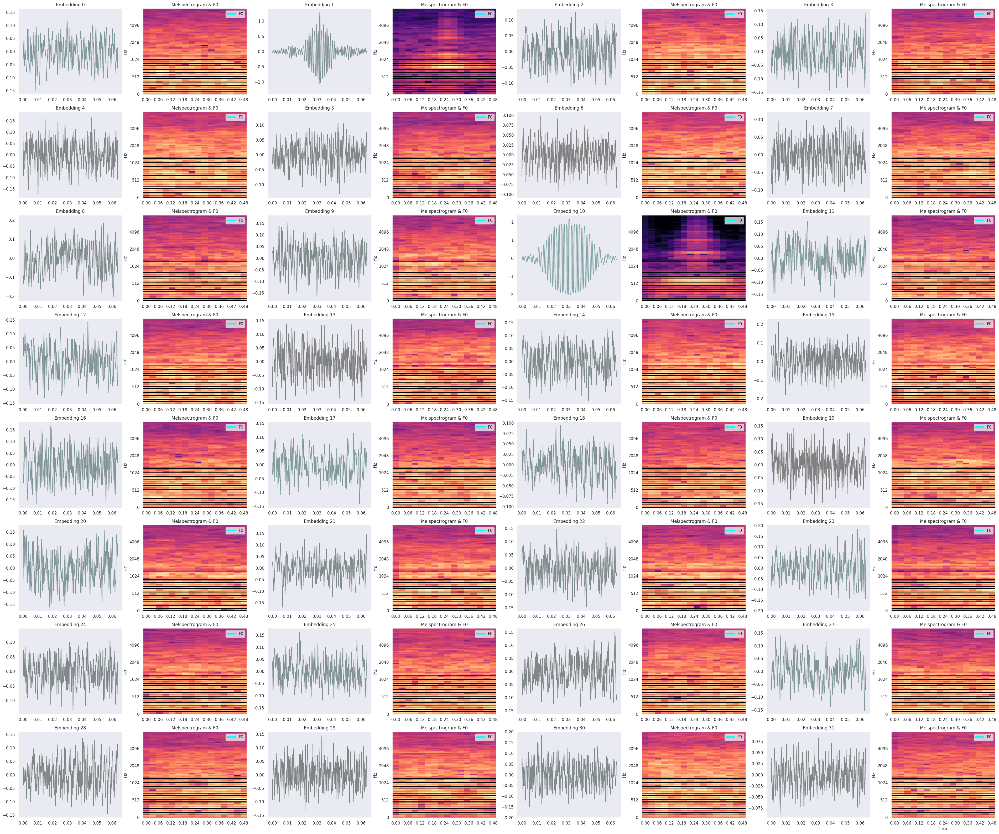

In [47]:
k, bz = 4, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

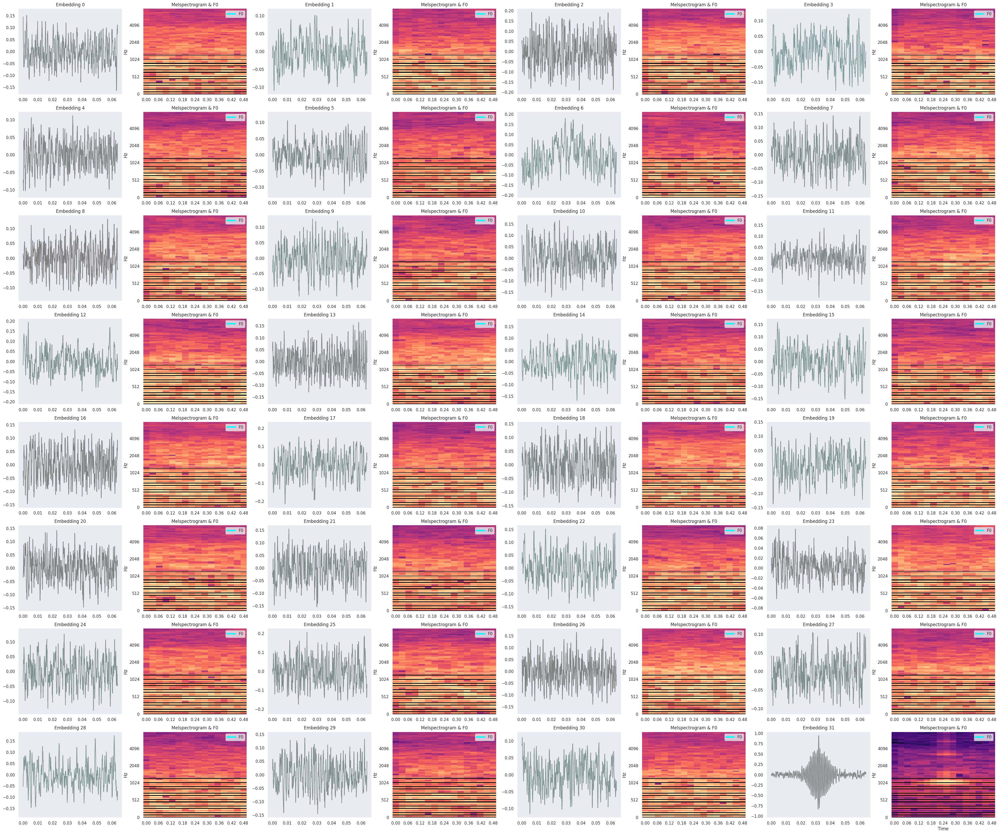

In [48]:
k, bz = 5, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

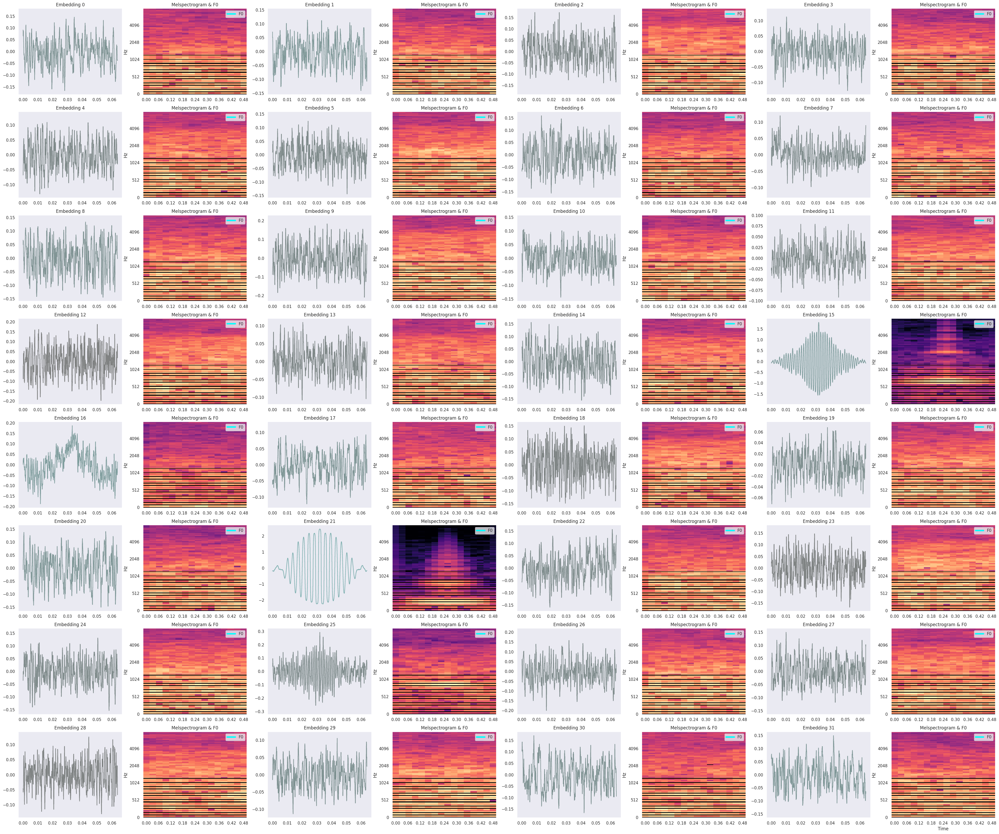

In [49]:
k, bz = 6, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

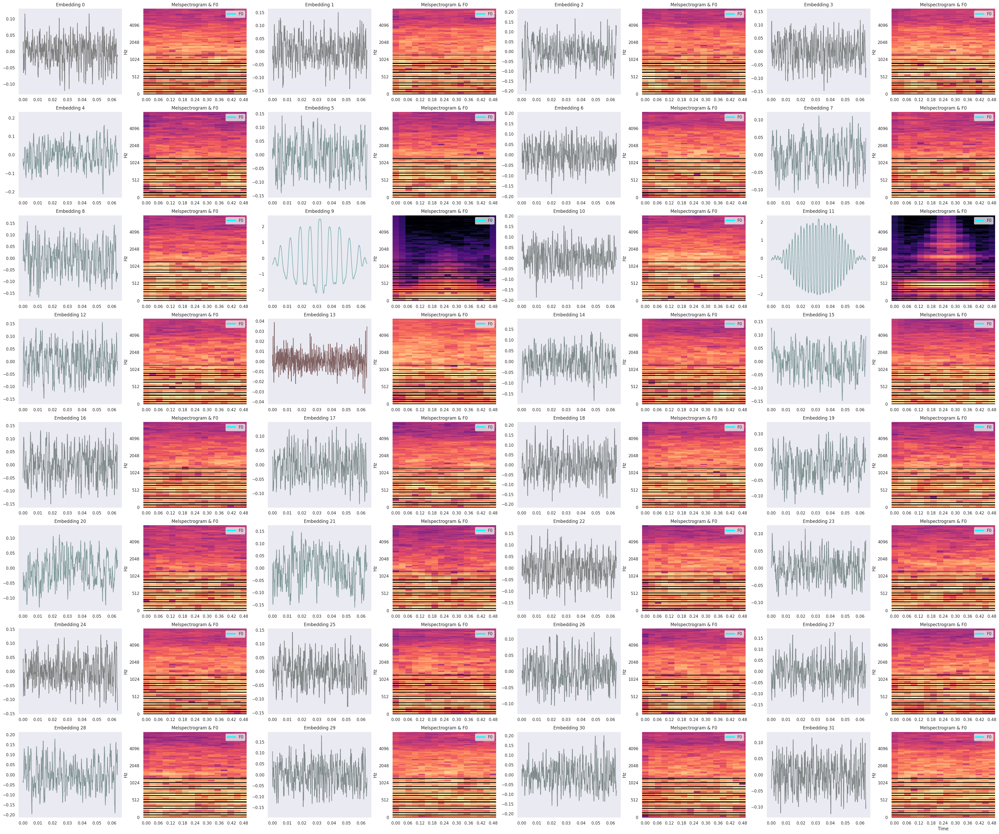

In [50]:
k, bz = 7, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

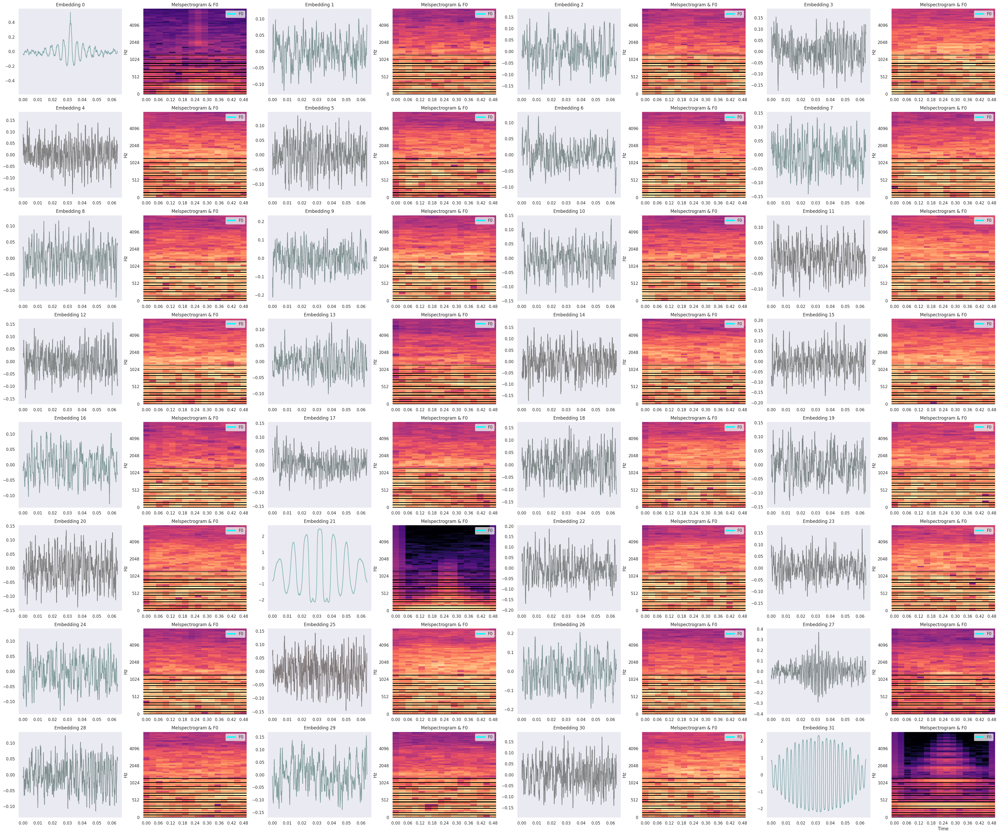

In [51]:
k, bz = 8, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

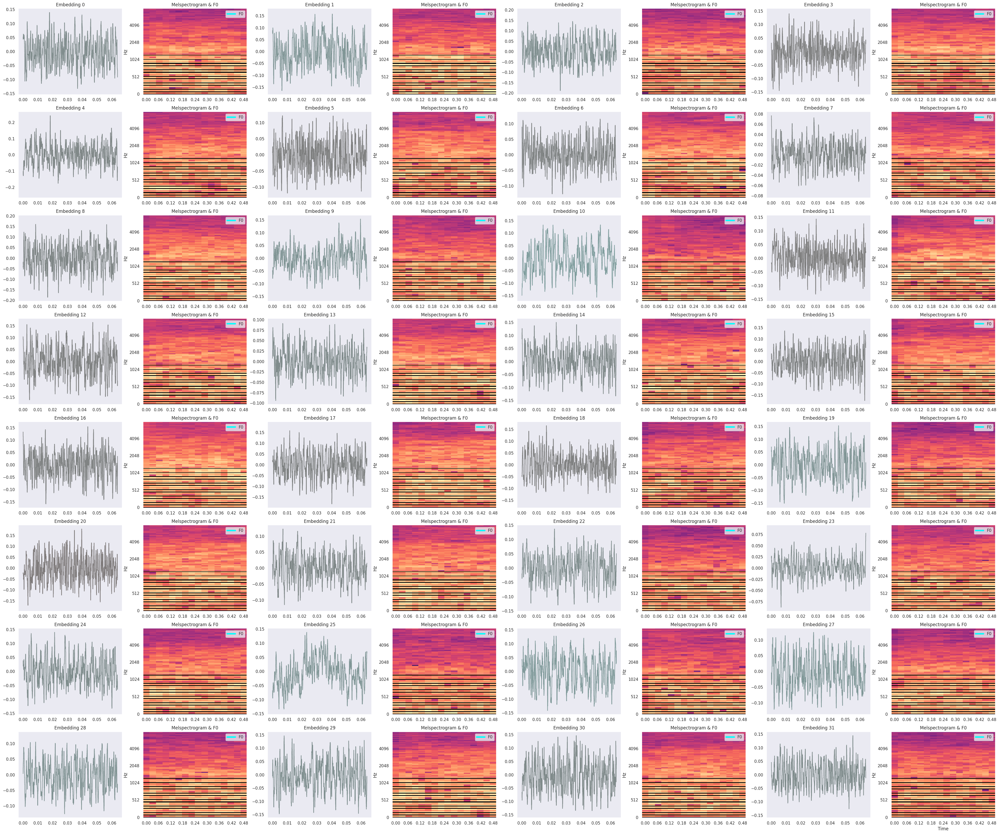

In [52]:
k, bz = 9, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

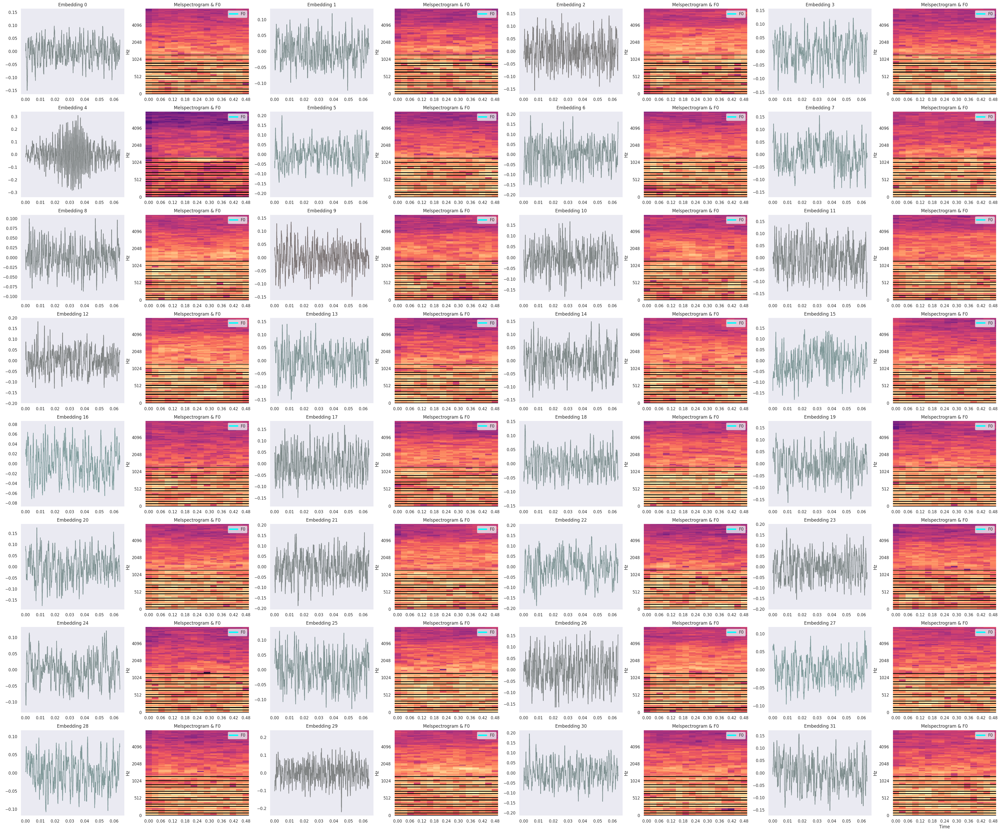

In [53]:
k, bz = 10, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

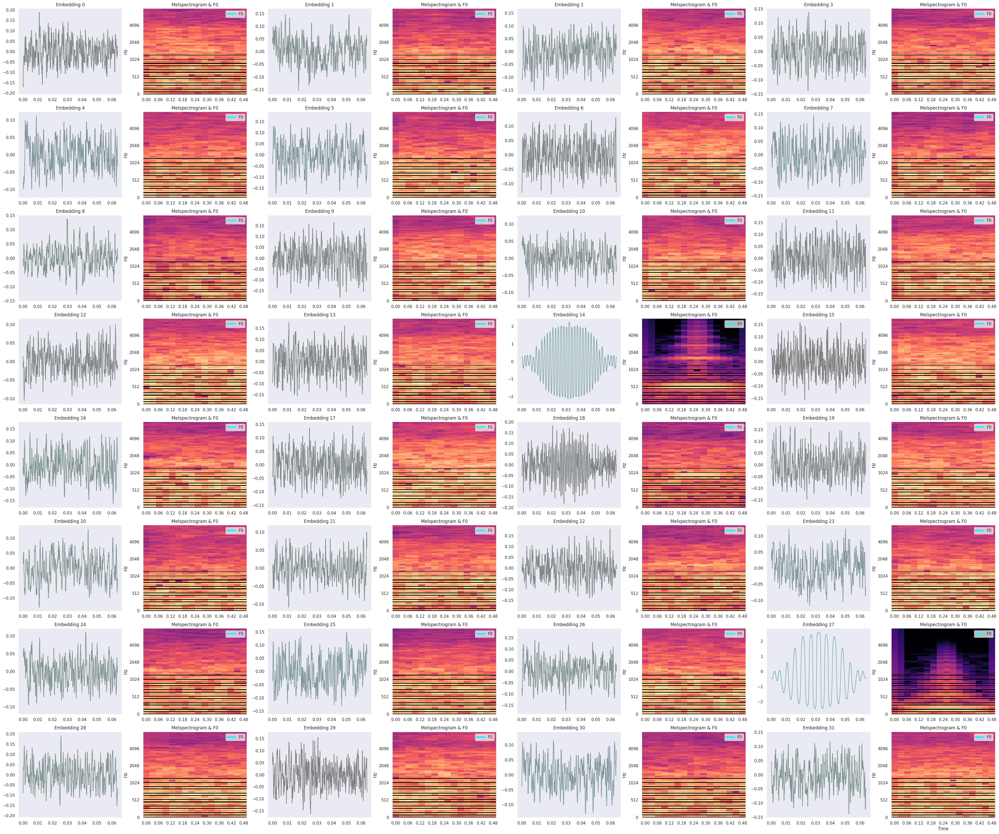

In [54]:
k, bz = 11, 32
selected_emb_idx = np.arange(k*bz, (k+1)*bz)
selected_emb_color = emb_color[selected_emb_idx]
visualize_speech_codebook(emb_data2.numpy()[selected_emb_idx], n=64, colors=selected_emb_color)

In [60]:
from IConNet.acov.audio import AudioLibrosa

In [66]:
selected_emb_np = selected_emb.numpy()

In [73]:
from IPython.display import display

In [75]:
for i in range(32):
    top_audio = AudioLibrosa(
        y=selected_emb_np[i], 
        sr=sr, title=f'Embedding top {i}',
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(i)
    display(top_audio.player)

0


1


2


3


4


5


6


7


8


9


10


11


12


13


14


15


16


17


18


19


20


21


22


23


24


25


26


27


28


29


30


31


In [ ]:
manual_selected_idx = [277, 233, 379, 127, 213, 
                       4, 287, 49, 256, 125, 
                       235, 366, 138, 29, 122,
                       298, 207, 208,]

In [103]:
manual_selected_voiced_idx = [
    4, 29, 49, 86, 125, 
    127, 129, 131, 138, 191, 
    207, 213, 233, 235, 256,
    277, 287, 366, 379
]

manual_selected_unvoiced_idx = [
    76, 101, 126, 128, 130, 
    131, 139, 208, 217, 283,
    285
]

In [104]:
emb_np = emb_data2.numpy()
for i in manual_selected_voiced_idx:
    title=f'Voiced Embedding {i}'
    top_audio = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(title)
    display(top_audio.player)

Voiced Embedding 4


Voiced Embedding 29


Voiced Embedding 49


Voiced Embedding 86


Voiced Embedding 125


Voiced Embedding 127


Voiced Embedding 129


Voiced Embedding 131


Voiced Embedding 138


Voiced Embedding 191


Voiced Embedding 207


Voiced Embedding 213


Voiced Embedding 233


Voiced Embedding 235


Voiced Embedding 256


Voiced Embedding 277


Voiced Embedding 287


Voiced Embedding 366


Voiced Embedding 379


In [79]:
for i in manual_selected_unvoiced_idx:
    title=f'Unvoiced Embedding {i}'
    top_audio = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        features_f0=False, features_fft=False, features_cqt=False
    )
    top_audio.extract_features()
    print(title)
    display(top_audio.player)

Unvoiced Embedding 6


Unvoiced Embedding 101


Unvoiced Embedding 126


Unvoiced Embedding 128


Unvoiced Embedding 130


Unvoiced Embedding 131


Unvoiced Embedding 139


Unvoiced Embedding 208


Unvoiced Embedding 217


Unvoiced Embedding 283


Unvoiced Embedding 285


In [92]:
from IConNet.acov.audio_viz import (
    feature_librosa, play_and_visualize, show_feature)

In [140]:
def display_embedding(i, title_prefix="Voiced "):
    title=f'{title_prefix}Embedding {i}'
    audio_top = AudioLibrosa(
        y=emb_np[i], 
        sr=sr, title=title,
        win_length=256
    )
    audio_top.extract_features()
    print(title)
    show_feature(audio_top)
    display(audio_top.player)

Voiced Embedding 4



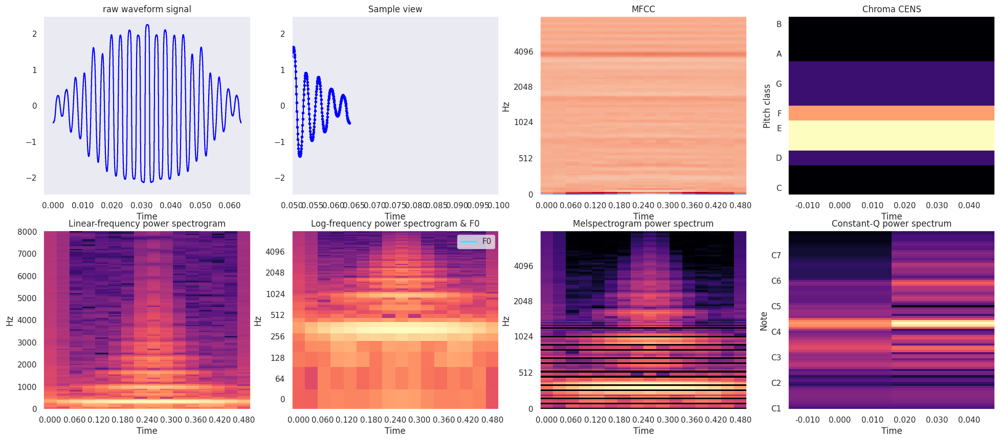

In [120]:
ii = 0
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 29



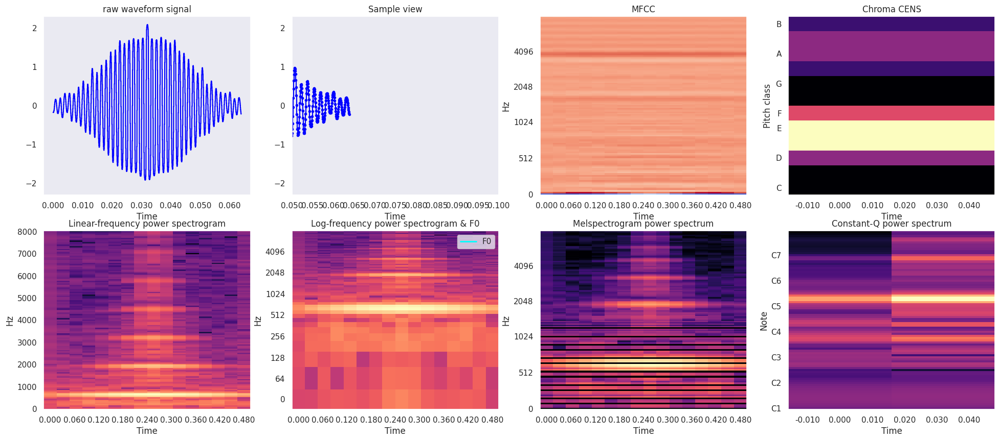

In [121]:
ii = 1
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 49



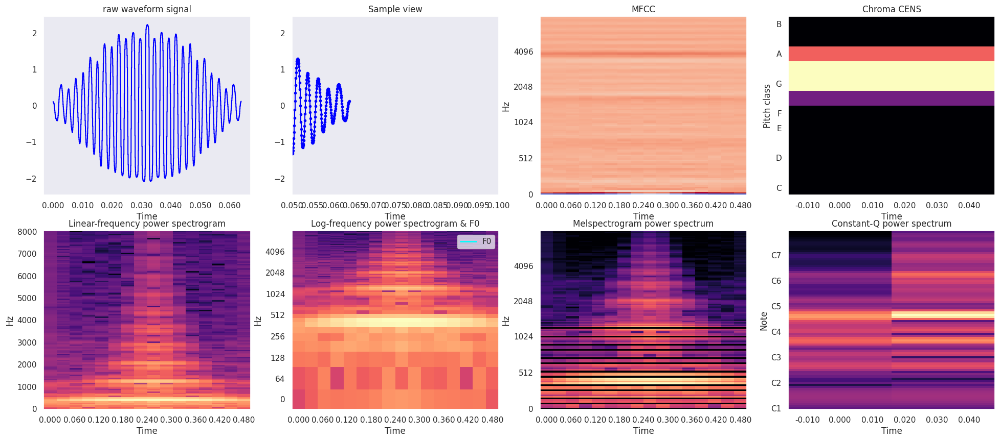

In [122]:
ii = 2
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 86



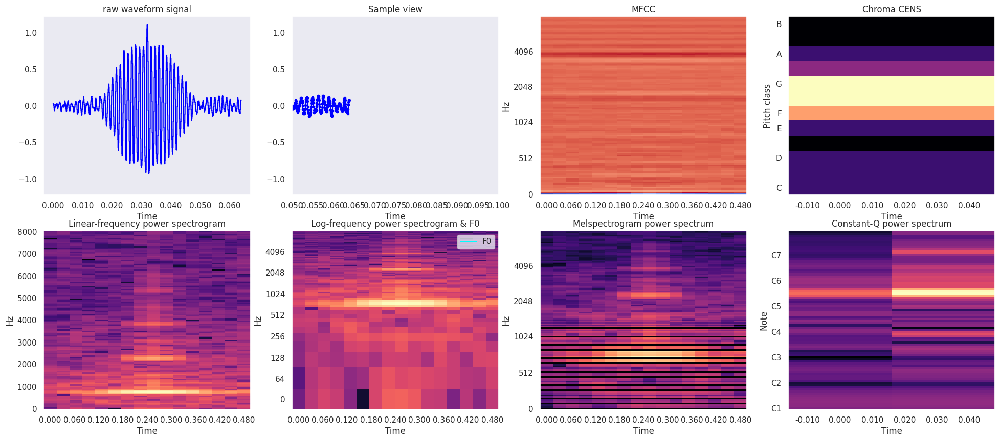

In [123]:
ii = 3
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 125



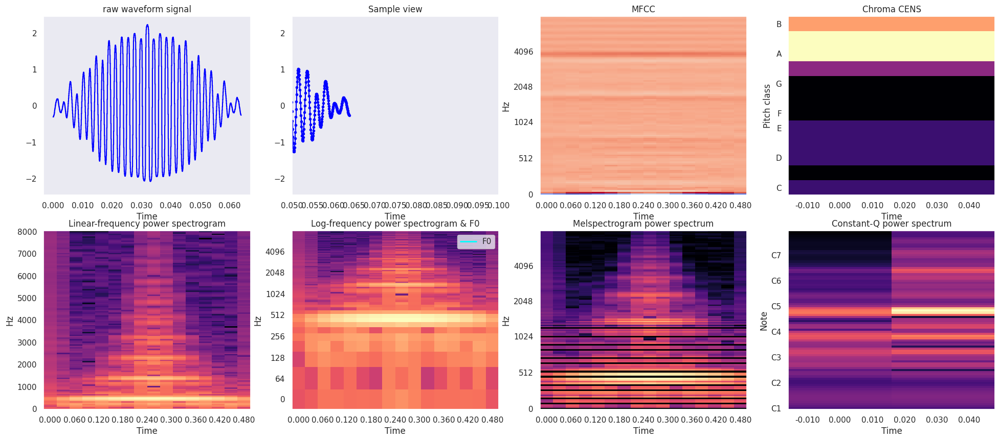

In [124]:
ii = 4
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 127



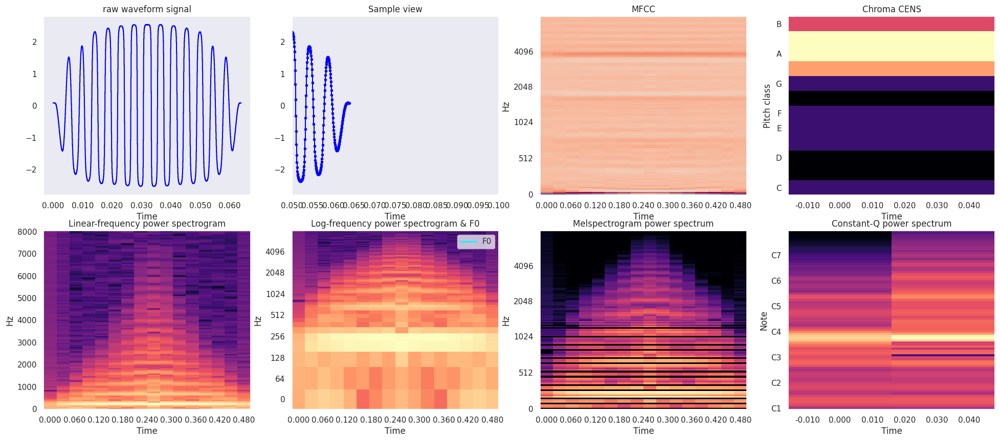

In [125]:
ii = 5
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 129



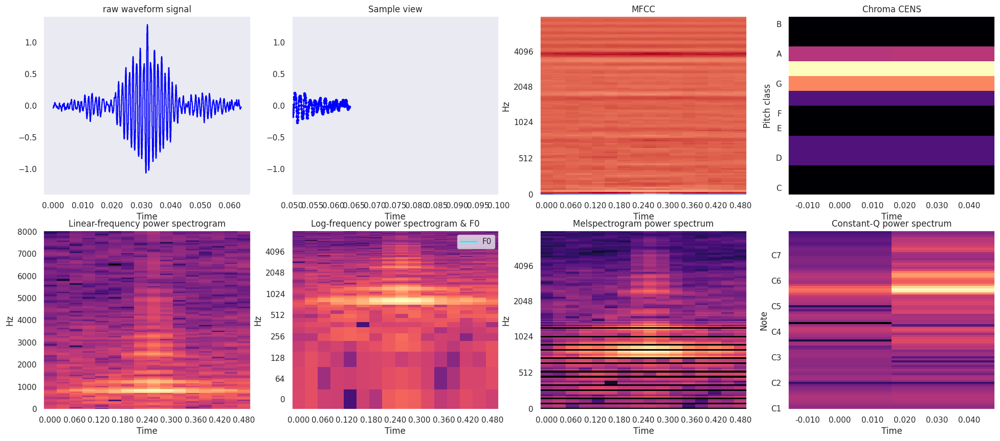

In [126]:
ii = 6
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 131



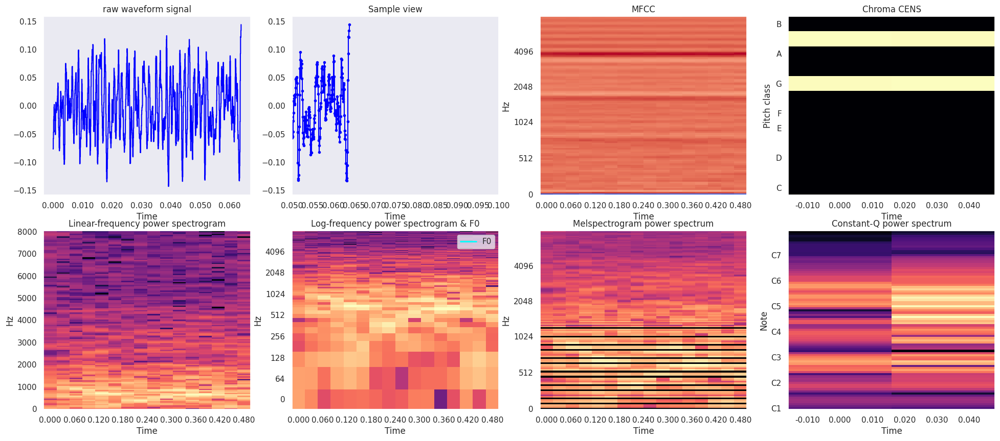

In [127]:
ii = 7
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 138



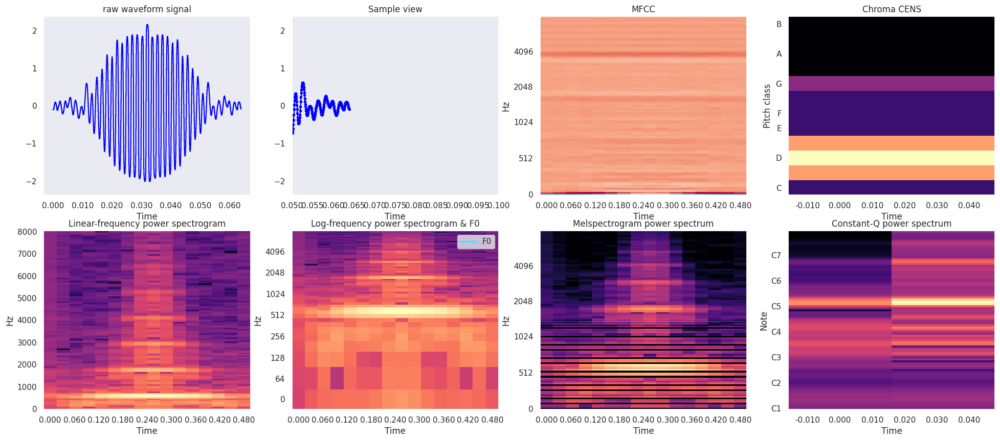

In [128]:
ii = 8
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 191



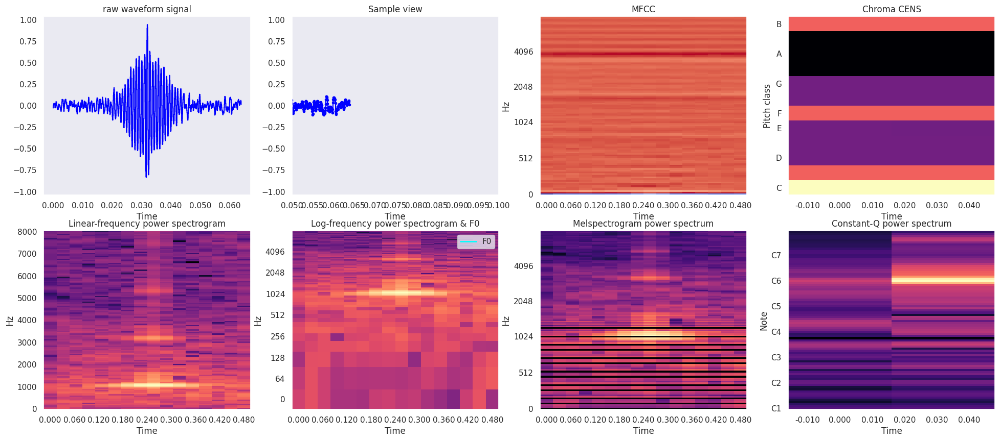

In [129]:
ii = 9
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 207



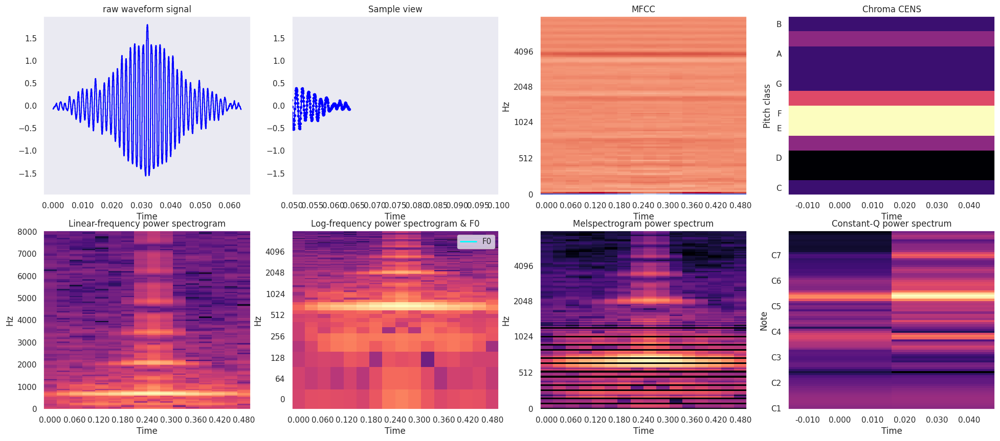

In [130]:
ii = 10
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 213



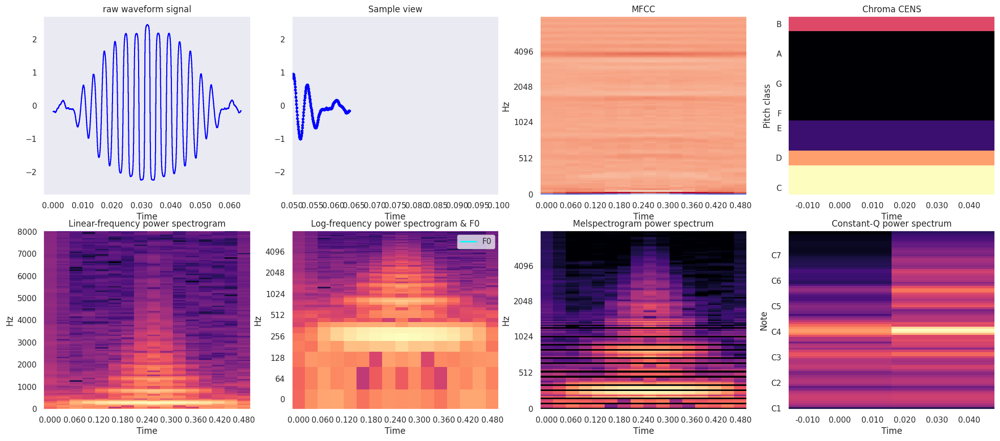

In [131]:
ii = 11
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 233



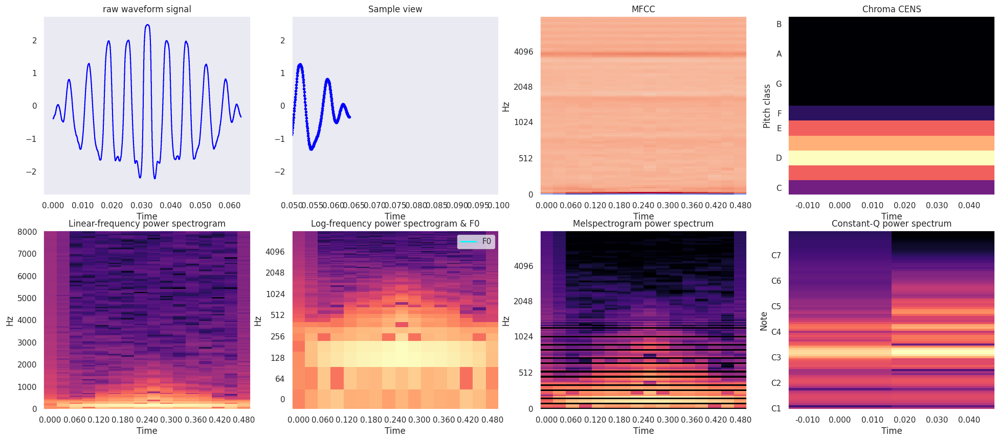

In [132]:
ii = 12
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 235



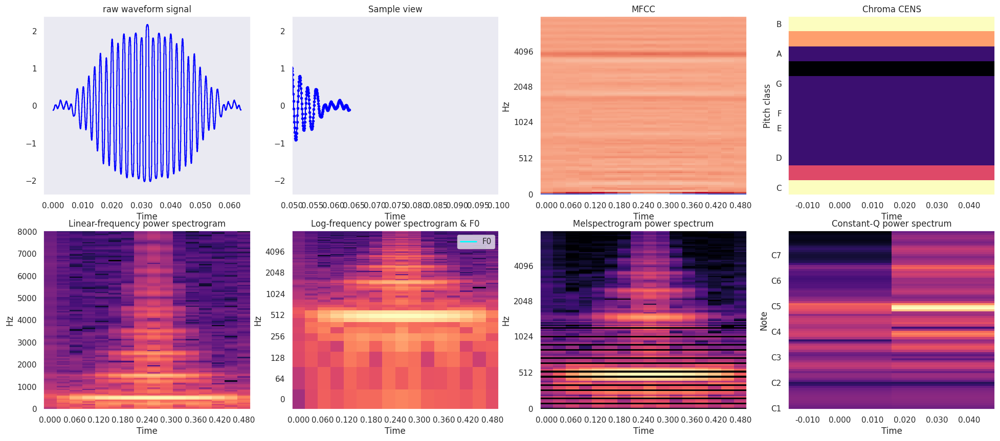

In [133]:
ii = 13
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 256



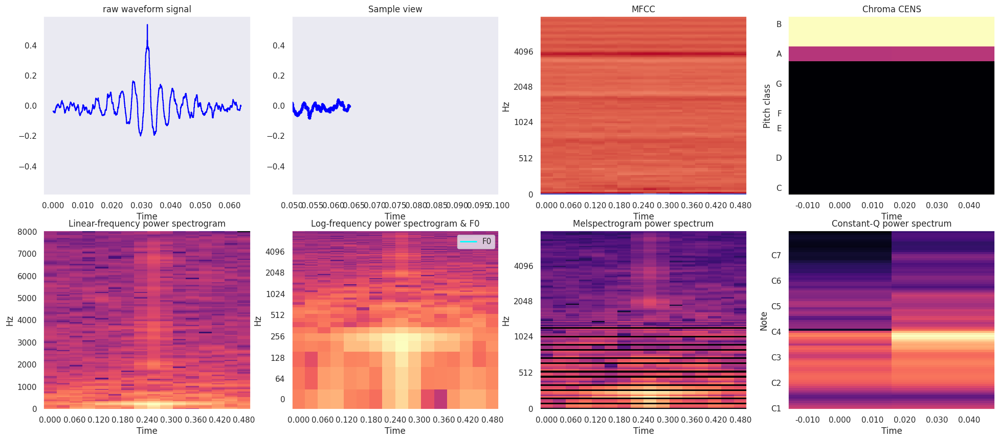

In [134]:
ii = 14
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 277



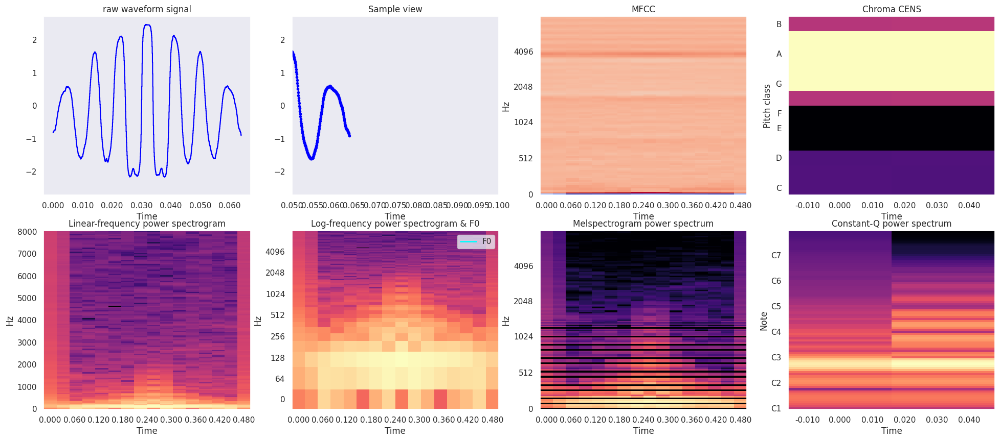

In [135]:
ii = 15
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 129



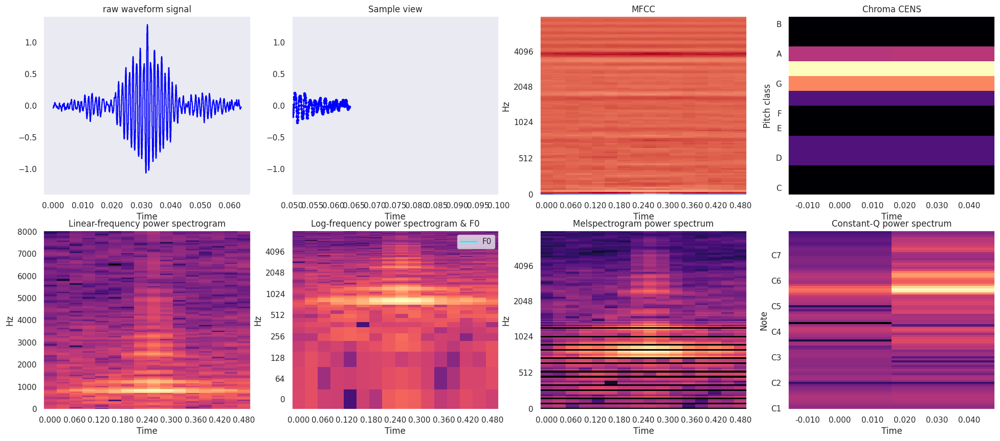

In [136]:
ii = 6
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 366



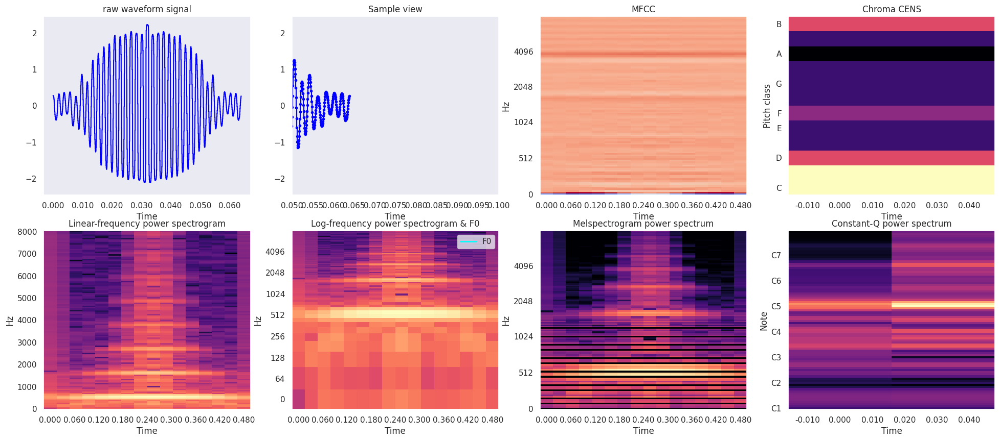

In [137]:
ii = 17
display_embedding(manual_selected_voiced_idx[ii])

Voiced Embedding 379



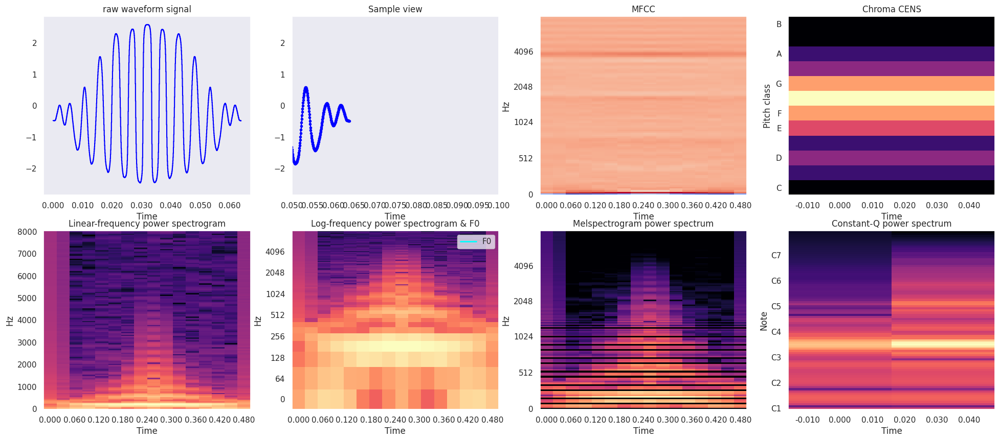

In [138]:
ii = 18
display_embedding(manual_selected_voiced_idx[ii])

Unvoiced Embedding 76



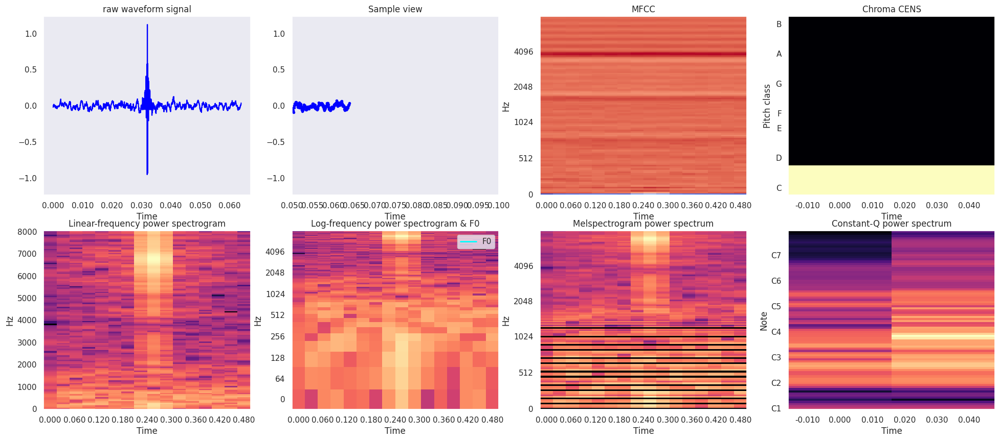

In [144]:
ii = 0
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 101



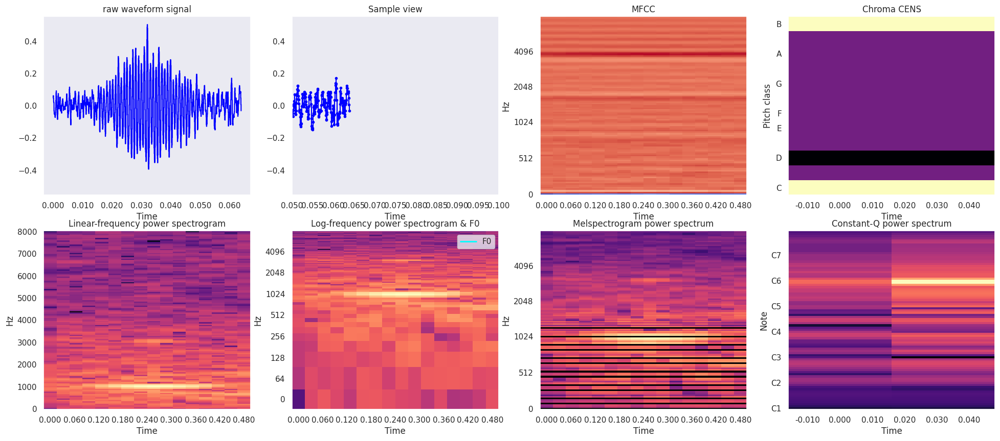

In [145]:
ii = 1
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 126



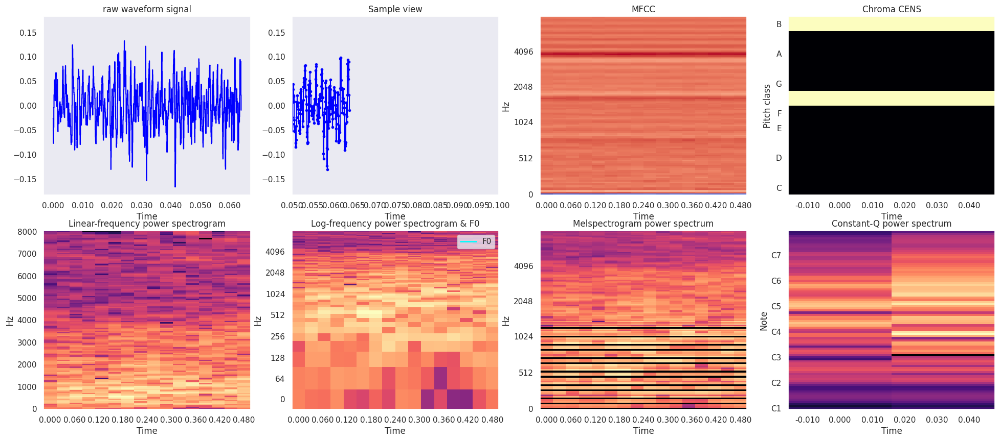

In [143]:
ii = 2
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 128



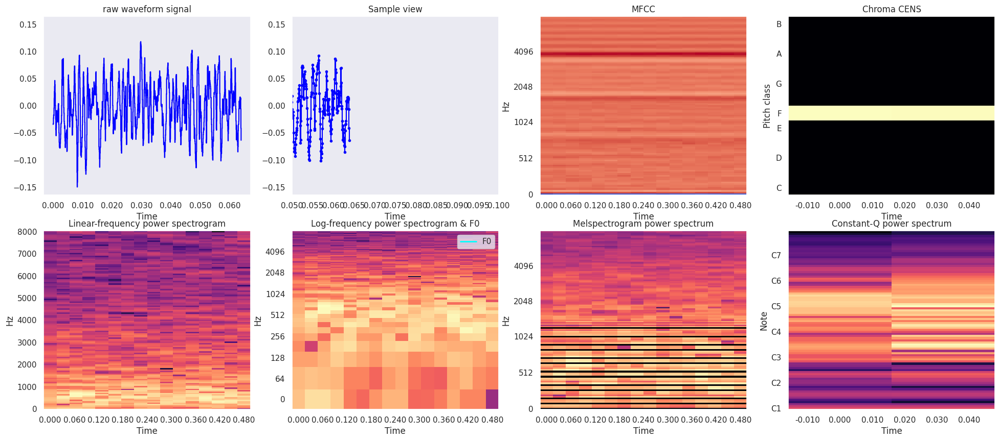

In [146]:
ii = 3
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 130



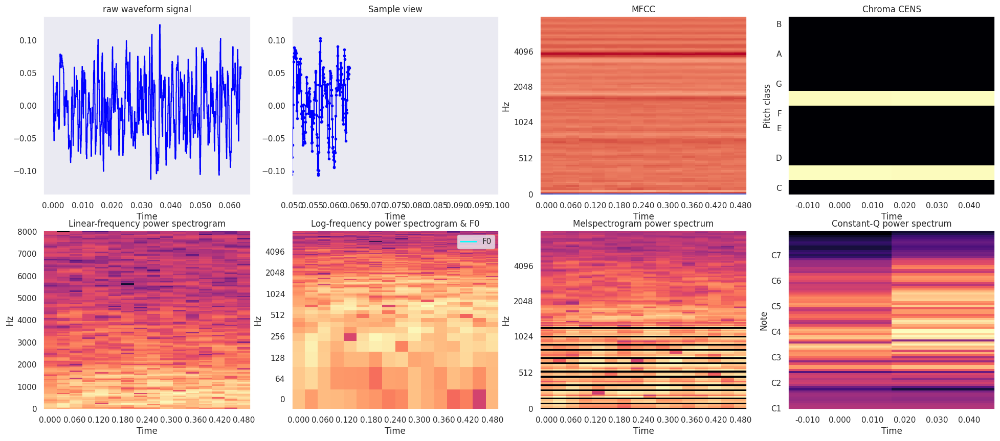

In [147]:
ii = 4
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 131



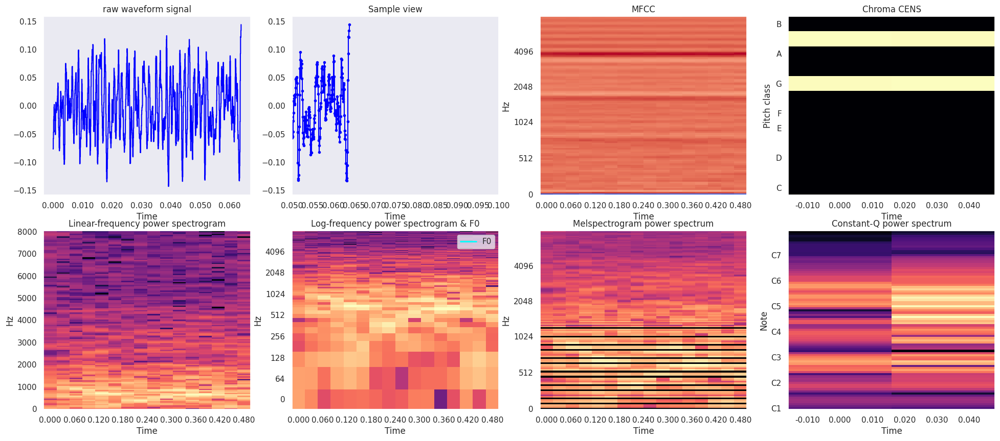

In [148]:
ii = 5
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 139



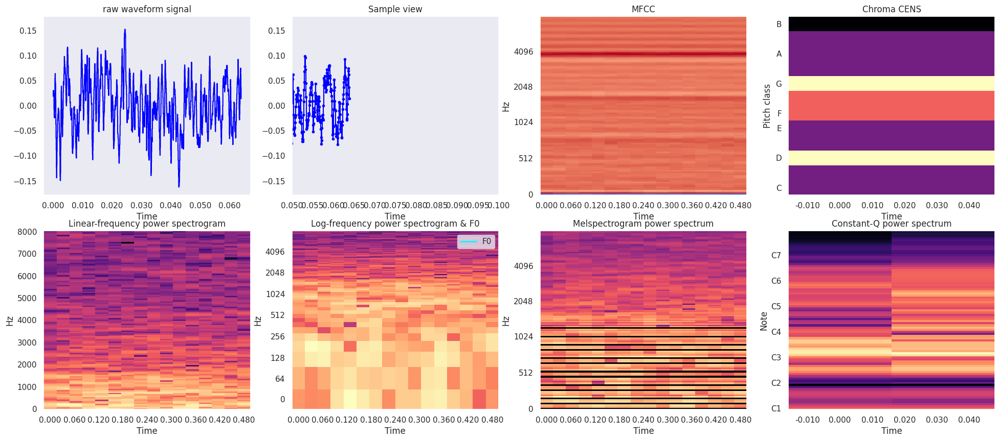

In [149]:
ii = 6
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 208



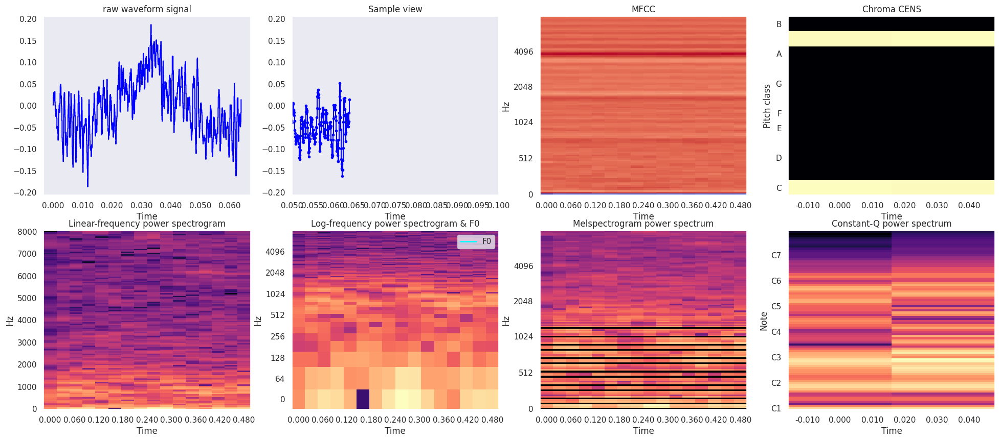

In [150]:
ii = 7
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 217



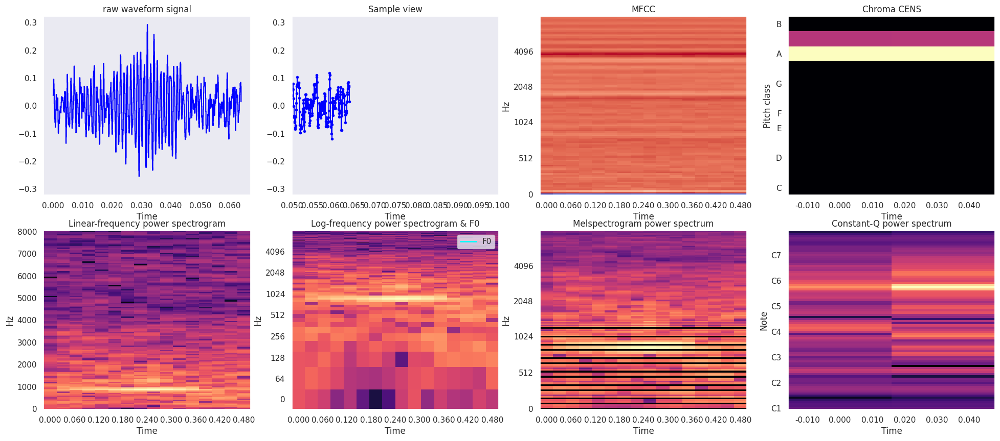

In [151]:
ii = 8
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 283



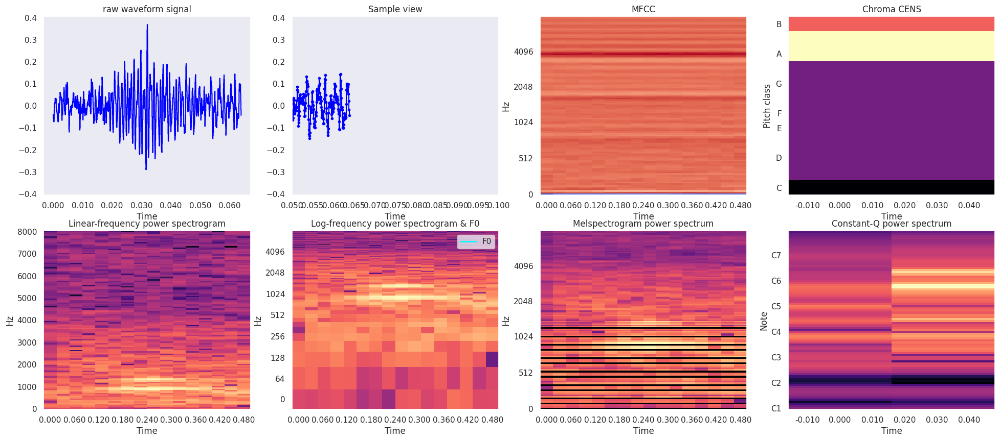

In [152]:
ii = 9
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Unvoiced Embedding 285



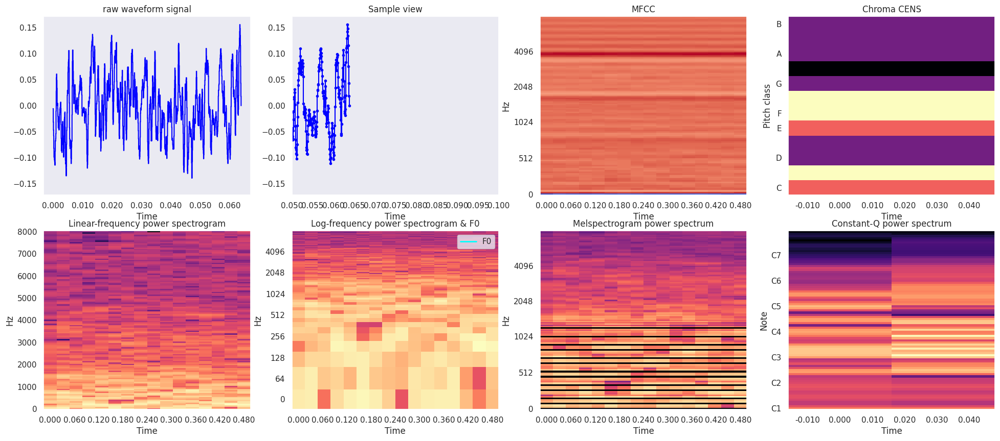

In [153]:
ii = 10
display_embedding(
    manual_selected_unvoiced_idx[ii], title_prefix="Unvoiced ")

Top 0 ZCscore Embedding 277



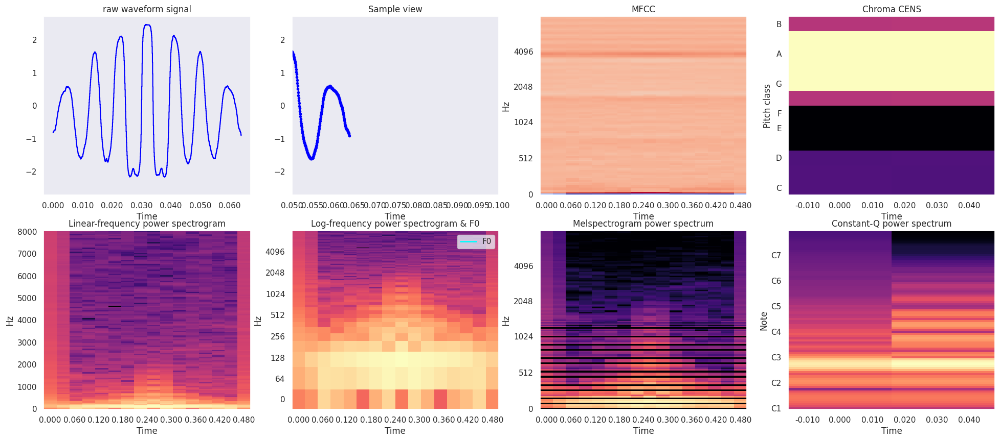

In [159]:
ii=0
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 20 ZCscore Embedding 285



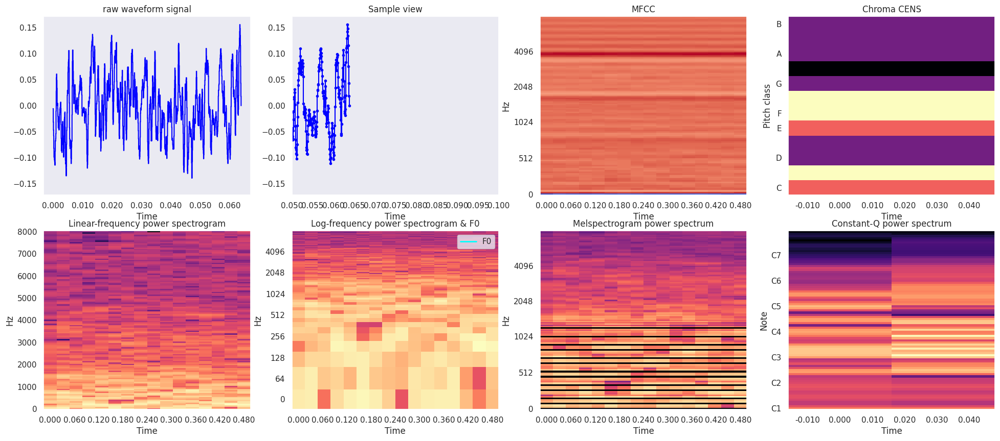

In [160]:
ii=20
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 22 ZCscore Embedding 115



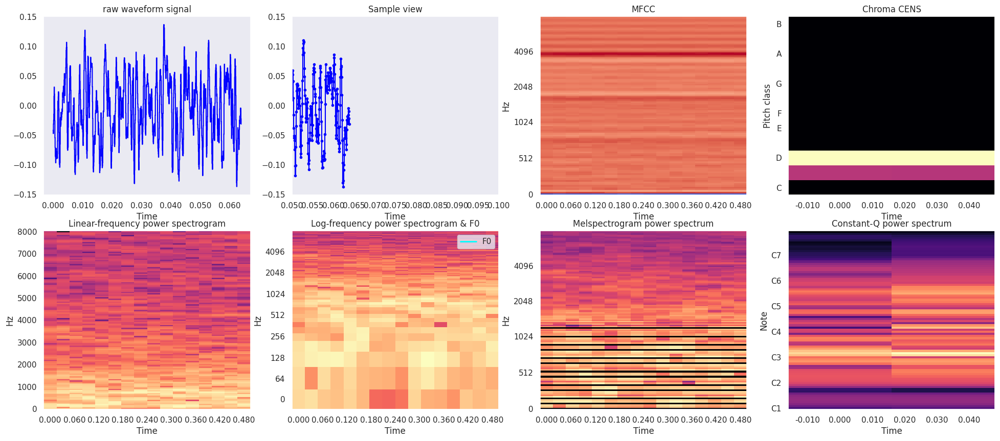

In [161]:
ii=22
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 24 ZCscore Embedding 69



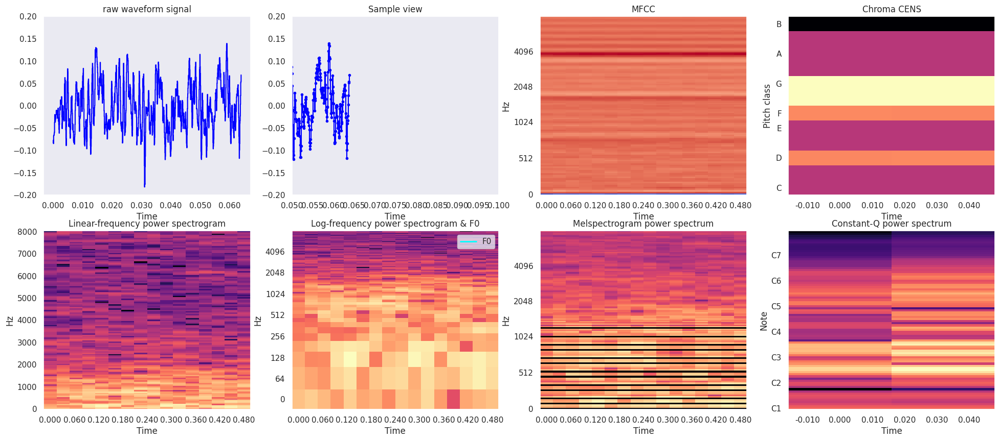

In [162]:
ii=24
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 26 ZCscore Embedding 244



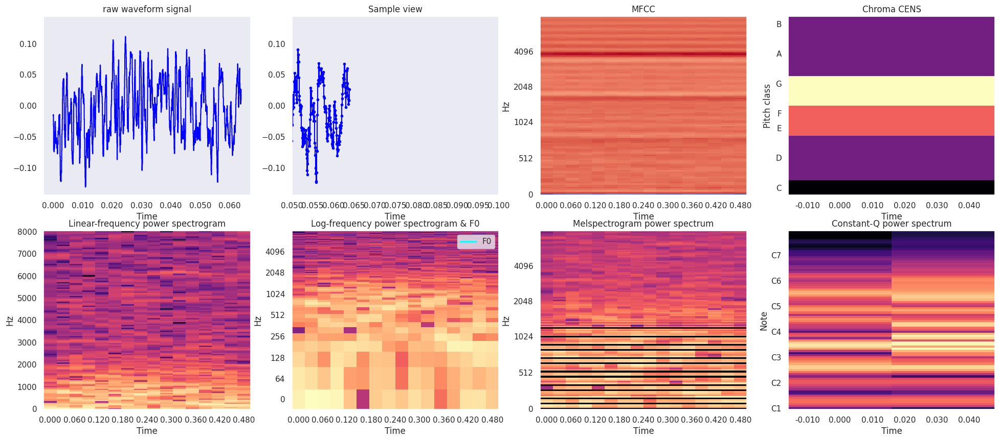

In [163]:
ii=26
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 28 ZCscore Embedding 314



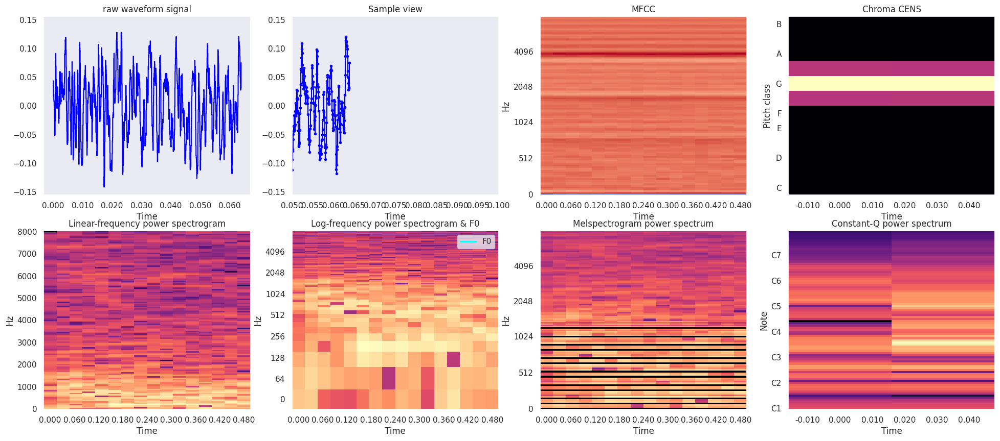

In [164]:
ii=28
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

Top 30 ZCscore Embedding 73



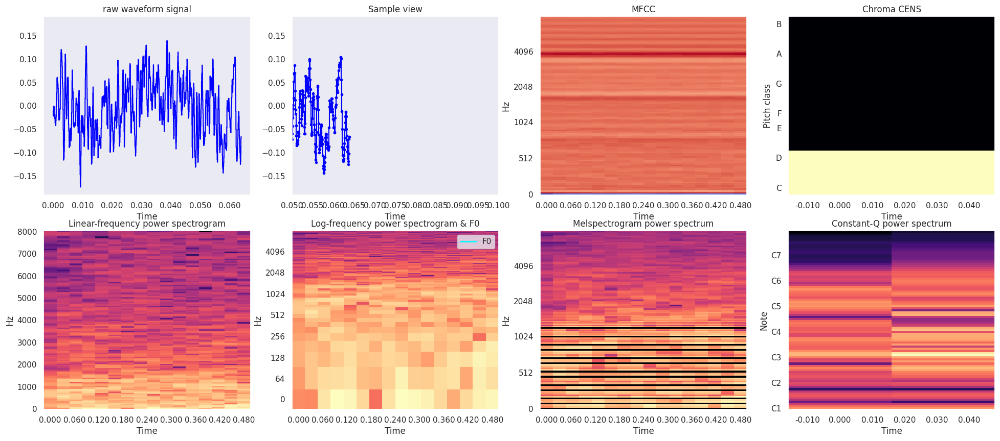

In [165]:
ii=30
selected_emb_topk_idx = selected_emb_topk.indices.numpy()
display_embedding(
    selected_emb_topk_idx[ii], f'Top {ii} ZCscore ')

In [214]:
emb_data

tensor([[ 0.0188,  0.0222,  0.0009,  ..., -0.0071,  0.0078,  0.0168],
        [ 0.0120,  0.0143,  0.0041,  ...,  0.0110,  0.0043,  0.0031],
        [ 0.0072,  0.0137,  0.0119,  ..., -0.0110, -0.0073, -0.0071],
        ...,
        [ 0.0305,  0.0301,  0.0354,  ..., -0.0372, -0.0526, -0.0633],
        [-0.0041, -0.0027, -0.0056,  ...,  0.0107,  0.0223,  0.0320],
        [ 0.0005, -0.0028, -0.0103,  ..., -0.0082, -0.0059, -0.0111]])

In [216]:
np.save(
    '../linh_scb6.audio_embedding.crema_d.step1k.npy', emb_data.numpy(), allow_pickle=True)

In [217]:
np.save(
    '../linh_scb6.audio_embedding.crema_d.step2k7.npy', emb_data2.numpy(), allow_pickle=True)

In [218]:
model_path = '../linh_scb6.model.crema_d.step2k7.pt'
torch.save(model.state_dict(), model_path)

In [ ]:
test_accuracy, train_res_cls_loss,
    train_res_recon_error, train_res_perplexity

In [220]:
np.save(
    '../linh_scb6.test_accuracy.crema_d.step2k7.npy', test_accuracy, allow_pickle=True)

In [222]:
np.save(
    '../linh_scb6.train_res_cls_loss.crema_d.step2k7.npy', train_res_cls_loss, allow_pickle=True)

In [223]:
np.save(
    '../linh_scb6.train_res_recon_error.crema_d.step2k7.npy', train_res_recon_error, allow_pickle=True)

In [224]:
np.save(
    '../linh_scb6.train_res_perplexity.crema_d.step2k7.npy', train_res_perplexity, allow_pickle=True)